In [1]:
import os

import torch
import torch.nn.functional as F
from torchvision import transforms
from PIL import Image, ImageDraw
from scipy.ndimage import distance_transform_edt
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from models.mobileSam.mobile_sam.modeling.sam import Sam



from models.mobile_sam_base import MobileSAMBase
from mobile_sam import sam_model_registry


/Users/noahmac/Desktop/uni/kandidat/9_semester/ATIA/project/mobileSam_adapter/.venv/lib/python3.13/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
/Users/noahmac/Desktop/uni/kandidat/9_semester/ATIA/project/mobileSam_adapter/.venv/lib/python3.13/site-packages/timm/models/layers/__init__.py:48: FutureWarning: Importing from timm.models.layers is deprecated, please import via timm.layers
  warnings.warn(f"Importing from {__name__} is deprecated, please import via timm.layers", FutureWarning)
/Users/noahmac/Desktop/uni/kandidat/9_semester/ATIA/project/mobileSam_adapter/.venv/lib/python3.13/site-packages/timm/models/registry.py:4: FutureWarning: Importing from timm.models.registry is deprecated, please import via timm.models
  warnings.warn(f"Importing from {__name__} is deprecated, please import via timm.models", FutureW

In [85]:

COD_ADAPTER_LORA_CHECKPOINT = "checkpoints/adapter_lora/cod/adapter_lora_cod/best_loss_model.pth"
COD_ADAPTER_CHECKPOINT = "checkpoints/adapter/cod/adapter_cod/best_loss_model.pth"
COD_LORA_CHECKPOINT = "checkpoints/lora/cod/lora_cod/best_loss_model.pth"
MOBILESAM_CHECPOINT = "models/mobileSam/weights/mobile_sam.pt"
COD_ADAPTER_LORA_PROMPT_CHECKPOINT = "checkpoints/adapter_lora/cod/adapter_lora_cod_prompt/best_loss_model.pth"
COD_ADAPTER_PROMPT_CHECKPOINT = "checkpoints/adapter/cod/adapter_cod_prompt/best_loss_model.pth"
COD_LORA_PROMPT_CHECKPOINT = "checkpoints/lora/cod/lora_cod_prompt/best_loss_model.pth"
# COD_ADAPTER_LORA_CHECKPOINT = "checkpoints/adapter_lora/cod/2025-10-20_22-13-07/best_model.pth"
# COD_ADAPTER_CHECKPOINT = "checkpoints/adapter/cod/2025-10-20_22-08-04/best_model.pth"
# COD_LORA_CHECKPOINT = "checkpoints/lora/cod/2025-10-20_22-01-00/best_model.pth"
# MOBILESAM_CHECPOINT = "models/mobileSam/weights/mobile_sam.pt"
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

In [12]:
def load_checkpoint(model, checkpoint_path, map_location="cpu", strict=True):
    """
    Loads a fine-tuned MobileSAM model that includes adapter layers.

    Args:
        model (torch.nn.Module): An *instantiated* MobileSAMBase model 
                                 (e.g., MobileSAMBase(use_adapter=True)).
        checkpoint_path (str): Path to the checkpoint file (.pth / .pt).
        map_location (str): Device to map tensors to (default: 'cpu').
        strict (bool): Whether to strictly enforce matching keys.
    """
    print(f"[INFO] Loading checkpoint from: {checkpoint_path}")
    checkpoint = torch.load(checkpoint_path, map_location=map_location)
    # Handle DDP or Lightning wrapping
    if "model_state_dict" in checkpoint:
        checkpoint = checkpoint["model_state_dict"]
    elif isinstance(checkpoint, dict) and "model" in checkpoint:
        checkpoint = checkpoint["model"]

    # Remove "module." prefix if model was saved under DDP
    state_dict = {}
    for k, v in checkpoint.items():
        if k.startswith("module."):
            k = k[len("module."):]
        state_dict[k] = v

    # Try loading
    missing_keys, unexpected_keys = model.load_state_dict(state_dict, strict=strict)

    if missing_keys:
        raise Exception(f"The following keys are missing in checkpoint: {missing_keys}")
    if unexpected_keys:
        raise Exception(f"The following unexpected keys are present in checkpoint: {unexpected_keys}")

    print("[INFO] Checkpoint successfully loaded.")

In [102]:




def resize_and_pad_for_visualizer(img_pil, target_size=1024):
    """Resize image to fit into target_size while preserving aspect ratio,
    then center-pad to (target_size, target_size). Returns the padded PIL image.
    """
    w, h = img_pil.size
    scale = target_size / max(w, h)
    new_w, new_h = int(round(w * scale)), int(round(h * scale))
    img_resized = img_pil.resize((new_w, new_h), resample=Image.BILINEAR)
    mode = img_pil.mode
    new_img = Image.new(mode, (target_size, target_size))
    pad_left = (target_size - new_w) // 2
    pad_top = (target_size - new_h) // 2
    new_img.paste(img_resized, (pad_left, pad_top))
    return new_img

def compute_pad_info(orig_w, orig_h, target_size=1024):
    """Return scale, new_w, new_h, pad_left, pad_top used when padding orig->target_size."""
    scale = target_size / max(orig_w, orig_h)
    new_w, new_h = int(round(orig_w * scale)), int(round(orig_h * scale))
    pad_left = (target_size - new_w) // 2
    pad_top  = (target_size - new_h) // 2
    return scale, new_w, new_h, pad_left, pad_top

def unpad_and_resize_mask_tensor(mask_tensor, orig_size, target_size=1024):
    """
    Convert a mask tensor in padded target_size coords -> numpy 2D in original image coords.
    mask_tensor: torch tensor with shape (H, W) or (1, H, W) or (1,1,H,W) in [0,1].
    orig_size: (orig_w, orig_h)
    Returns: numpy 2D mask in {0,1} shaped (orig_h, orig_w)
    """
    orig_w, orig_h = orig_size
    scale, new_w, new_h, pad_left, pad_top = compute_pad_info(orig_w, orig_h, target_size=target_size)

    # Convert to 2D numpy float [0,1]
    mask_np = mask_tensor.cpu().numpy()
    mask_np = np.squeeze(mask_np)
    mask_np = np.clip(mask_np, 0.0, 1.0)

    # Sanity: if mask not the expected target_size, try to resize it to target_size first
    if mask_np.shape != (target_size, target_size):
        # convert to PIL and resize to target_size (nearest)
        tmp = Image.fromarray((mask_np * 255).astype(np.uint8))
        tmp = tmp.resize((target_size, target_size), resample=Image.NEAREST)
        mask_np = np.array(tmp) / 255.0

    # Crop the padded region that corresponds to the resized original image
    crop = mask_np[pad_top: pad_top + new_h, pad_left: pad_left + new_w]
    # Resize crop back to original image size (orig_w, orig_h) using nearest to preserve binary masks
    crop_pil = Image.fromarray((crop * 255).astype(np.uint8))
    crop_resized_pil = crop_pil.resize((orig_w, orig_h), resample=Image.NEAREST)
    crop_resized = np.array(crop_resized_pil) / 255.0
    # Binarize to 0/1
    crop_resized = (crop_resized > 0.5).astype(np.uint8)
    return crop_resized

def overlay_mask_on_original(image_pil, mask_np2d, color=(255,0,0), alpha=0.5):
    """
    image_pil: original PIL RGB image
    mask_np2d: numpy 2D binary mask shaped (H, W) matching image_pil.size
    returns blended RGB numpy array
    """
    image_np = np.array(image_pil).astype(np.uint8)
    # ensure mask shape matches image
    if mask_np2d.shape != image_np.shape[:2]:
        raise ValueError("mask and image sizes don't match for overlay.")
    overlay = np.zeros_like(image_np, dtype=np.uint8)
    overlay[mask_np2d > 0] = color
    blended = (image_np * (1 - alpha) + overlay * alpha).astype(np.uint8)
    return blended



def get_point_from_mask(mask_tensor: torch.Tensor):
    """Return center point of mask, projected to nearest foreground pixel if outside."""
    mask_np = mask_tensor.squeeze().cpu().numpy() > 0.5
    if mask_np.sum() == 0:
        return None

    ys, xs = np.where(mask_np)
    y_center = ys.mean()
    x_center = xs.mean()

    # check if center is inside mask
    y_c, x_c = int(round(y_center)), int(round(x_center))
    if mask_np[y_c, x_c]:
        return torch.tensor([[x_center, y_center]], dtype=torch.float32)

    # if not, project to nearest mask pixel using distance transform
    dist, indices = distance_transform_edt(~mask_np, return_indices=True)
    nearest_y, nearest_x = indices[:, y_c, x_c]
    return torch.tensor([[nearest_x, nearest_y]], dtype=torch.float32)


def scale_point_coords(point, original_size, padded_size):
    """
    Scale a single point from padded input coordinates to original image size.
    point: Tensor of shape (B=1, N=1, 2)
    original_size: tuple (w,h)
    padded_size: int or tuple (H,W)
    """
    orig_w, orig_h = original_size
    if isinstance(padded_size, int):
        padded_h, padded_w = padded_size, padded_size
    else:
        padded_h, padded_w = padded_size

    point = point.squeeze(0).squeeze(0)  # now shape (2,) -> x,y
    x = point[0] * (orig_w / padded_w)
    y = point[1] * (orig_h / padded_h)
    return torch.tensor([x, y])

def draw_point_on_image(pil_image, point, color=(0, 0, 255), radius=20):
    """Draw a single point on a PIL image."""
    if point is None:
        return pil_image
    img = pil_image.copy()
    draw = ImageDraw.Draw(img)
    x, y = point[0].item(), point[1].item()  # convert from tensor to float
    draw.ellipse([x-radius, y-radius, x+radius, y+radius], fill=color)
    return img

def visualize_mobilesam_models(models : list[tuple[str, Sam]], image_path, gt_path=None, alpha=0.5,
                               save_masks=False, save_dir="./pred_masks",
                               target_size=1024, legacy=False, help_sam=False, help_adapters=False):
    device = next(models[0][1].parameters()).device
    image_pil = Image.open(image_path).convert("RGB")
    orig_w, orig_h = image_pil.size

    # --- Load GT mask if available (padded to target_size) ---
    gt_mask_padded = None
    if gt_path is not None:
        gt_mask = Image.open(gt_path).convert("L")   # make single channel
        gt_mask_padded = resize_and_pad_for_visualizer(gt_mask, target_size)
        gt_mask_padded = transforms.ToTensor()(gt_mask_padded).to(device)
        gt_mask_padded = (gt_mask_padded > 0.5).float()   # shape: (1, target_size, target_size)

    # --- Get point prompt from GT if available ---
    point_coords = None
    if gt_mask_padded is not None:
        point_coords = get_point_from_mask(gt_mask_padded).to(device)  # shape: 1x2
        if point_coords is not None:
            point_coords = point_coords.unsqueeze(0)  # batch dim: B=1, N=1, 2
            point_labels = torch.ones(point_coords.shape[:2], device=device)  # 1=foreground
        else:
            point_coords = None
            point_labels = None
    else:
        point_coords = None
        point_labels = None

    if save_masks and not os.path.exists(save_dir):
        os.makedirs(save_dir)

    img_resized_padded = resize_and_pad_for_visualizer(image_pil, target_size)
    
    pred_masks_padded = []
    ious = []

    for name, model in models:
        model.eval()
        is_baseline = name.lower() in ["mobilesam", "sam"] 
        use_point_coords = (help_adapters and not is_baseline) or (is_baseline and help_sam)
        input_tensor = transforms.ToTensor()(img_resized_padded).to(device)


        if legacy:
            if is_baseline:
                input_tensor = input_tensor * 255.0
                mean = torch.tensor([123.675, 116.28, 103.53], device=device).view(3,1,1)
                std  = torch.tensor([58.395, 57.12, 57.375], device=device).view(3,1,1)
                input_tensor = (input_tensor - mean) / std
        else:
            input_tensor = input_tensor * 255.0
            mean = torch.tensor([123.675, 116.28, 103.53], device=device).view(3,1,1)
            std  = torch.tensor([58.395, 57.12, 57.375], device=device).view(3,1,1)
            input_tensor = (input_tensor - mean) / std


        batched_input = {
            "image": input_tensor,
            "original_size": (target_size, target_size),
        }

        if use_point_coords and point_coords is not None:
            batched_input["point_coords"] = point_coords
            batched_input["point_labels"] = point_labels
        # print(name, batched_input.keys())
        # print(point_coords, point_coords.shape)
        # print(point_labels, point_labels.shape)
        with torch.no_grad():
            outputs = model([batched_input], multimask_output=False)

        pred_mask = outputs[0]["masks"][0]   # shape may be (H,W) or (1,H,W)
        if pred_mask.ndim == 3:
            pred_mask = pred_mask[0]
        # ensure float and padded-target_size
        pred_mask_padded = F.interpolate(pred_mask.unsqueeze(0).unsqueeze(0).float(),
                                         size=(target_size, target_size), mode="nearest").squeeze()
        pred_masks_padded.append((name, pred_mask_padded))

        # compute IoU on ORIGINAL image coordinates (more intuitive):
        if gt_mask_padded is not None:
            # convert both to original coords
            pred_orig = unpad_and_resize_mask_tensor(pred_mask_padded, (orig_w, orig_h), target_size=target_size)
            gt_orig   = unpad_and_resize_mask_tensor(gt_mask_padded, (orig_w, orig_h), target_size=target_size)
            intersection = np.logical_and(pred_orig, gt_orig).sum()
            union = np.logical_or(pred_orig, gt_orig).sum()
            iou = float(intersection / union) if union > 0 else float("nan")
            ious.append(iou)
        else:
            ious.append(None)

        if save_masks:
            out_np = (pred_mask_padded.cpu().numpy() * 255).astype(np.uint8)
            Image.fromarray(out_np).save(os.path.join(save_dir, f"{name}_{os.path.basename(image_path)}"))

    # --- Prepare visualization grid (top: overlays, bottom: binary masks aligned to original image size) ---
    n_cols = 1 + (1 if gt_mask_padded is not None else 0) + len(pred_masks_padded)
    fig, axes = plt.subplots(2, n_cols, figsize=(4 * n_cols, 8))
    axes = np.atleast_2d(axes)

    # Top-left: original image
    col = 0
    axes[0, col].imshow(image_pil)
    axes[0, col].set_title("Original Image", fontsize=22)  # increase font
    axes[0, col].axis("off")

    # If GT exists: overlay GT next to original
    if gt_mask_padded is not None:
        col += 1
        gt_orig_np = unpad_and_resize_mask_tensor(gt_mask_padded, (orig_w, orig_h), target_size=target_size)
        gt_overlay = overlay_mask_on_original(image_pil, gt_orig_np, color=(0,255,0), alpha=alpha)
        axes[0, col].imshow(gt_overlay)
        axes[0, col].set_title("Ground Truth (overlay)", fontsize=22)
        axes[0, col].axis("off")

    # Model overlays
    for i, (name, pred_padded) in enumerate(pred_masks_padded):
        col += 1
        pred_orig_np = unpad_and_resize_mask_tensor(pred_padded, (orig_w, orig_h), target_size=target_size)
        overlay = overlay_mask_on_original(image_pil, pred_orig_np, color=(255,0,0), alpha=alpha)
        if name.lower() in ["mobilesam", "sam"] and point_coords is not None and help_sam or (point_coords is not None and help_adapters):
            overlay_pil = Image.fromarray(overlay) if overlay.dtype != np.uint8 else Image.fromarray(overlay)
            point_scaled = scale_point_coords(point_coords, (orig_w, orig_h), target_size)
            overlay_pil = draw_point_on_image(overlay_pil, point_scaled)
            overlay = np.array(overlay_pil)

        axes[0, col].imshow(overlay)
        title = name
        if ious[i] is not None:
            title += f" (IoU={ious[i]:.3f})"
        axes[0, col].set_title(title, fontsize=22)  # increase font
        axes[0, col].axis("off")

    # --- Bottom row: binary masks ---
    col = 0
    axes[1, col].imshow(np.zeros((orig_h, orig_w)), cmap="gray")
    axes[1, col].set_title("", fontsize=22)
    axes[1, col].axis("off")

    if gt_mask_padded is not None:
        col += 1
        axes[1, col].imshow(gt_orig_np, cmap="gray")
        axes[1, col].set_title("GT Mask (orig size)", fontsize=22)
        axes[1, col].axis("off")

    for i, (_, pred_padded) in enumerate(pred_masks_padded):
        col += 1
        pred_orig_np = unpad_and_resize_mask_tensor(pred_padded, (orig_w, orig_h), target_size=target_size)
        axes[1, col].imshow(pred_orig_np, cmap="gray")
        axes[1, col].set_title(f"{pred_masks_padded[i][0]} Mask", fontsize=22)
        axes[1, col].axis("off")


    plt.tight_layout()
    plt.show()

    return pred_masks_padded, ious

In [87]:
mobileSamAdapterCod = MobileSAMBase()
mobileSamAdapterCod.add_adapter()
load_checkpoint(mobileSamAdapterCod, COD_ADAPTER_CHECKPOINT)
mobileSamAdapterCod.eval()

mobileSamLoraCod = MobileSAMBase()
mobileSamLoraCod.add_lora()
load_checkpoint(mobileSamLoraCod, COD_LORA_CHECKPOINT)
mobileSamLoraCod.eval()


mobileSamBothCod = MobileSAMBase()
mobileSamBothCod.add_adapter()
mobileSamBothCod.add_lora()
load_checkpoint(mobileSamBothCod, COD_ADAPTER_LORA_CHECKPOINT)
mobileSamBothCod.eval()



mobileSamAdapterCodPrompt = MobileSAMBase()
mobileSamAdapterCodPrompt.add_adapter()
load_checkpoint(mobileSamAdapterCodPrompt, COD_ADAPTER_PROMPT_CHECKPOINT)
mobileSamAdapterCodPrompt.eval()

mobileSamLoraCodPrompt = MobileSAMBase()
mobileSamLoraCodPrompt.add_lora()
load_checkpoint(mobileSamLoraCodPrompt, COD_LORA_PROMPT_CHECKPOINT)
mobileSamLoraCodPrompt.eval()


mobileSamBothCodPrompt = MobileSAMBase()
mobileSamBothCodPrompt.add_adapter()
mobileSamBothCodPrompt.add_lora()
load_checkpoint(mobileSamBothCodPrompt, COD_ADAPTER_LORA_PROMPT_CHECKPOINT)
mobileSamBothCodPrompt.eval()



mobileSam = sam_model_registry["vit_t"](checkpoint=MOBILESAM_CHECPOINT)
mobileSam.eval()
print()

[INFO] Params before adding adapters:
[INFO] Trainable params: 0.000M
[INFO] Pretrained params: 0.000M
[INFO] Total params: 10.130M
[INFO] Adapter attached.
[INFO] Trainable params: 0.038M
[INFO] Pretrained params: 0.000M
[INFO] Total params: 10.168M
[INFO] Loading checkpoint from: checkpoints/adapter/cod/adapter_cod/best_loss_model.pth
[INFO] Checkpoint successfully loaded.
[INFO] Params before adding adapters:
[INFO] Trainable params: 0.000M
[INFO] Pretrained params: 0.000M
[INFO] Total params: 10.130M
[INFO] LoRA applied.
[INFO] Trainable params: 0.089M
[INFO] Pretrained params: 0.000M
[INFO] Total params: 10.219M
[INFO] Loading checkpoint from: checkpoints/lora/cod/lora_cod/best_loss_model.pth
[INFO] Checkpoint successfully loaded.
[INFO] Params before adding adapters:
[INFO] Trainable params: 0.000M
[INFO] Pretrained params: 0.000M
[INFO] Total params: 10.130M
[INFO] Adapter attached.
[INFO] Trainable params: 0.038M
[INFO] Pretrained params: 0.000M
[INFO] Total params: 10.168M
[IN

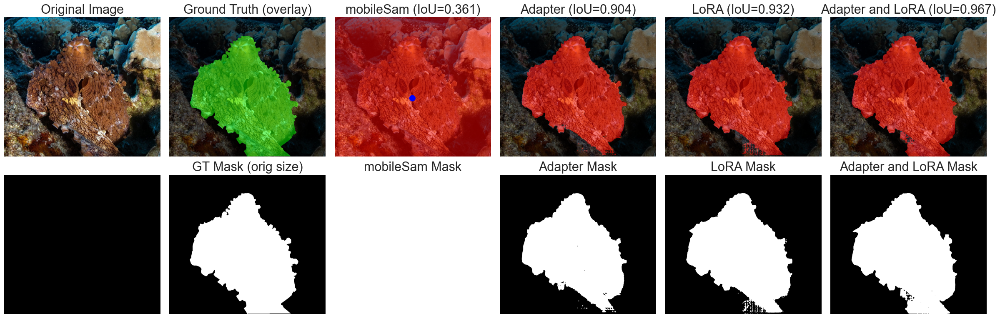

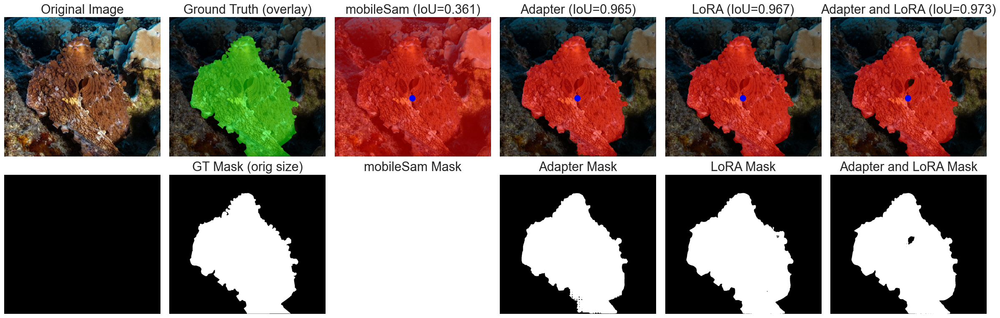

In [103]:
models = [("mobileSam", mobileSam), ("Adapter", mobileSamAdapterCod), ("LoRA", mobileSamLoraCod), ("Adapter and LoRA", mobileSamBothCod)]
image_name = "COD10K-CAM-1-Aquatic-11-Octopus-472"

img_path = f"data/cod/test/images/{image_name}.jpg"
mask_path = f"data/cod/test/masks/{image_name}.png"

visualize_mobilesam_models(models, img_path, mask_path, legacy=False, help_sam=True, help_adapters=False)
print()

models = [("mobileSam", mobileSam), ("Adapter", mobileSamAdapterCodPrompt), ("LoRA", mobileSamLoraCodPrompt), ("Adapter and LoRA", mobileSamBothCodPrompt)]

visualize_mobilesam_models(models, img_path, mask_path, legacy=False, help_sam=True, help_adapters=True)
print()

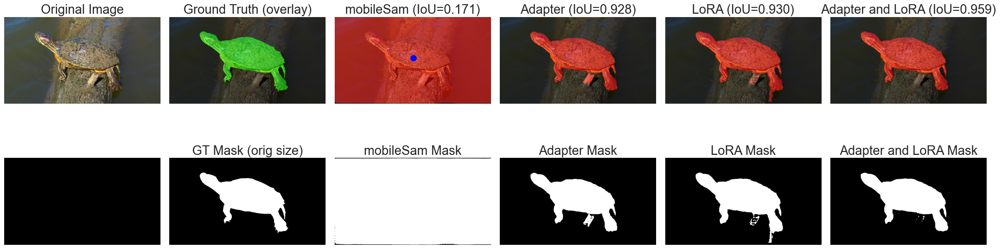

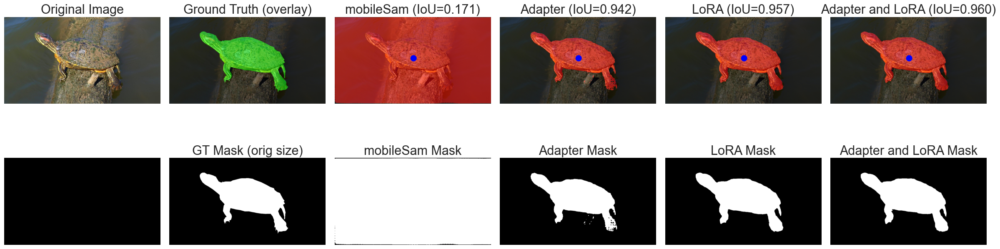

In [104]:
models = [("mobileSam", mobileSam), ("Adapter", mobileSamAdapterCod), ("LoRA", mobileSamLoraCod), ("Adapter and LoRA", mobileSamBothCod)]
image_name = "COD10K-CAM-1-Aquatic-20-Turtle-1218"

img_path = f"data/cod/val/images/{image_name}.jpg"
mask_path = f"data/cod/val/masks/{image_name}.png"

visualize_mobilesam_models(models, img_path, mask_path, legacy=False, help_sam=True, help_adapters=False)
print()

models = [("mobileSam", mobileSam), ("Adapter", mobileSamAdapterCodPrompt), ("LoRA", mobileSamLoraCodPrompt), ("Adapter and LoRA", mobileSamBothCodPrompt)]

visualize_mobilesam_models(models, img_path, mask_path, legacy=False, help_sam=True, help_adapters=True)
print()

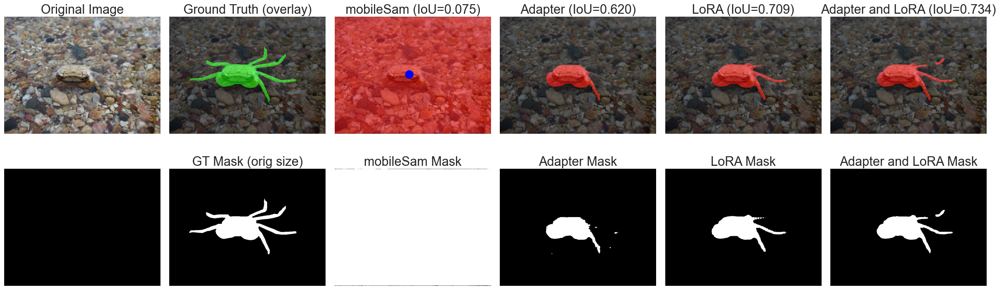

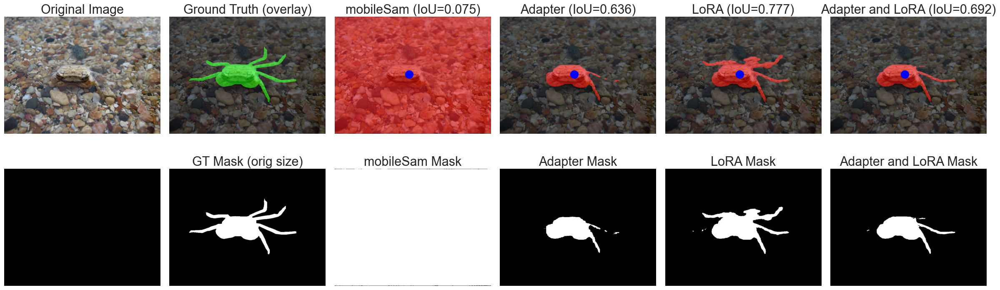

In [105]:
models = [("mobileSam", mobileSam), ("Adapter", mobileSamAdapterCod), ("LoRA", mobileSamLoraCod), ("Adapter and LoRA", mobileSamBothCod)]
image_name = "COD10K-CAM-1-Aquatic-3-Crab-48"

img_path = f"data/cod/val/images/{image_name}.jpg"
mask_path = f"data/cod/val/masks/{image_name}.png"

visualize_mobilesam_models(models, img_path, mask_path, legacy=False, help_sam=True, help_adapters=False)
print()

models = [("mobileSam", mobileSam), ("Adapter", mobileSamAdapterCodPrompt), ("LoRA", mobileSamLoraCodPrompt), ("Adapter and LoRA", mobileSamBothCodPrompt)]

visualize_mobilesam_models(models, img_path, mask_path, legacy=False, help_sam=True, help_adapters=True)
print()



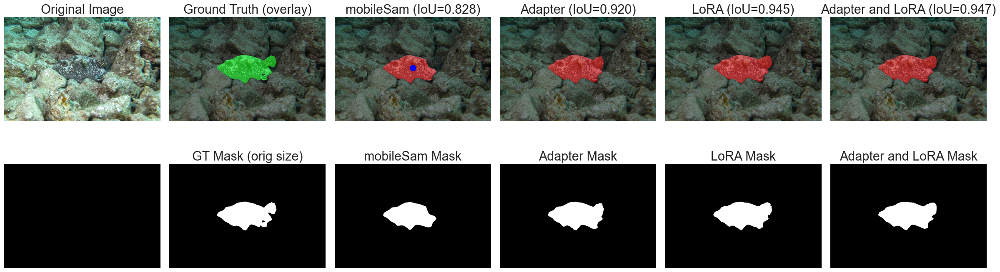

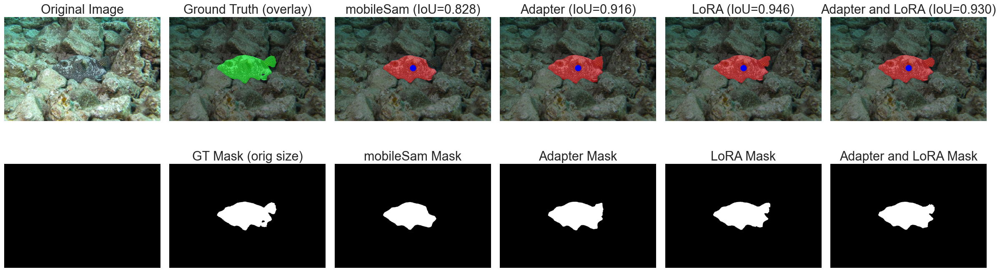

In [106]:
models = [("mobileSam", mobileSam), ("Adapter", mobileSamAdapterCod), ("LoRA", mobileSamLoraCod), ("Adapter and LoRA", mobileSamBothCod)]
image_name = "COD10K-CAM-1-Aquatic-6-Fish-140"

img_path = f"data/cod/val/images/{image_name}.jpg"
mask_path = f"data/cod/val/masks/{image_name}.png"

visualize_mobilesam_models(models, img_path, mask_path, legacy=False, help_sam=True, help_adapters=False)
print()

models = [("mobileSam", mobileSam), ("Adapter", mobileSamAdapterCodPrompt), ("LoRA", mobileSamLoraCodPrompt), ("Adapter and LoRA", mobileSamBothCodPrompt)]

visualize_mobilesam_models(models, img_path, mask_path, legacy=False, help_sam=True, help_adapters=True)
print()


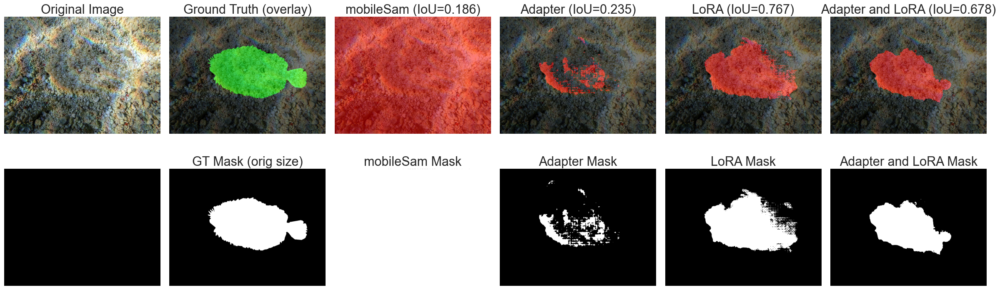

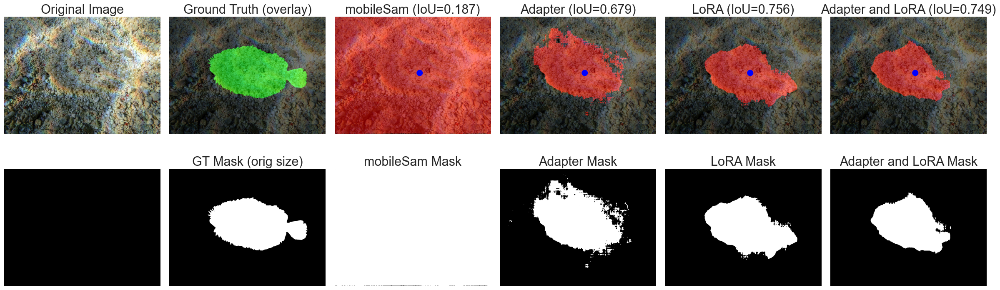

In [ ]:
models = [("mobileSam", mobileSam), ("Adapter", mobileSamAdapterCod), ("LoRA", mobileSamLoraCod), ("Adapter and LoRA", mobileSamBothCod)]
image_name = "COD10K-CAM-1-Aquatic-7-Flounder-261"

img_path = f"data/cod/val/images/{image_name}.jpg"
mask_path = f"data/cod/val/masks/{image_name}.png"

visualize_mobilesam_models(models, img_path, mask_path, legacy=False, help_sam=False, help_adapters=False)
print()

models = [("mobileSam", mobileSam), ("Adapter", mobileSamAdapterCodPrompt), ("LoRA", mobileSamLoraCodPrompt), ("Adapter and LoRA", mobileSamBothCodPrompt)]

visualize_mobilesam_models(models, img_path, mask_path, legacy=False, help_sam=True, help_adapters=True)
print()


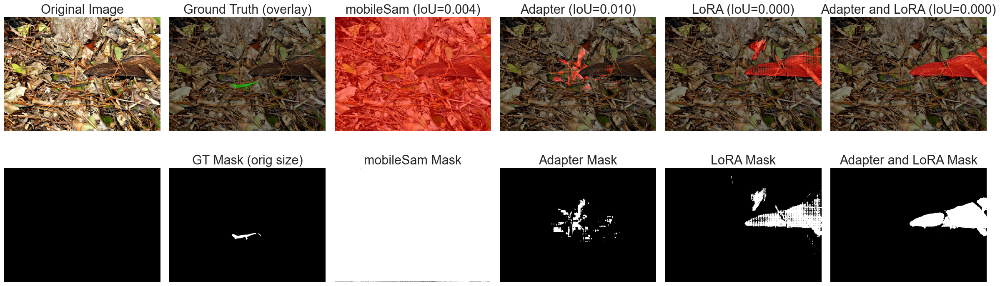

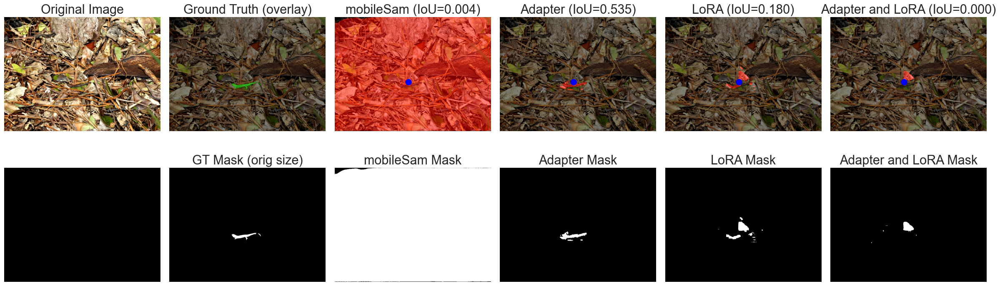

In [120]:


models = [("mobileSam", mobileSam), ("Adapter", mobileSamAdapterCod), ("LoRA", mobileSamLoraCod), ("Adapter and LoRA", mobileSamBothCod)]
image_name = "COD10K-CAM-2-Terrestrial-38-Lizard-2190"

img_path = f"data/cod/test/images/{image_name}.jpg"
mask_path = f"data/cod/test/masks/{image_name}.png"

visualize_mobilesam_models(models, img_path, mask_path, legacy=False, help_sam=False, help_adapters=False)
print()

models = [("mobileSam", mobileSam), ("Adapter", mobileSamAdapterCodPrompt), ("LoRA", mobileSamLoraCodPrompt), ("Adapter and LoRA", mobileSamBothCodPrompt)]

visualize_mobilesam_models(models, img_path, mask_path, legacy=False, help_sam=True, help_adapters=True)
print()


In [80]:
def visualize_example(image_path, mask_path, color=(255, 0, 0), alpha=0.5):
    """
    Display an image, its binary mask, and an overlay side by side.
    
    Args:
        image_path (str): Path to the RGB image.
        mask_path (str): Path to the mask image (binary or grayscale).
        color (tuple): RGB color for the overlay mask (default red).
        alpha (float): Transparency level for overlay (0-1).
    """
    # --- Load image and mask ---
    image = Image.open(image_path).convert("RGB")
    mask = Image.open(mask_path).convert("L")  # grayscale
    
    image_np = np.array(image)
    mask_np = np.array(mask)
    
    # Normalize and binarize mask (ensure it's 0 or 1)
    mask_bin = (mask_np > 127).astype(np.uint8)
    
    # --- Create overlay ---
    overlay = image_np.copy()
    overlay_mask = np.zeros_like(image_np)
    overlay_mask[mask_bin > 0] = color
    blended = (image_np * (1 - alpha) + overlay_mask * alpha).astype(np.uint8)
    
    # --- Plot side by side ---
    fig, axes = plt.subplots(1, 3, figsize=(15, 5))
    
    axes[0].imshow(image_np)
    axes[0].set_title("Original Image")
    axes[0].axis("off")
    
    axes[1].imshow(mask_bin, cmap="gray")
    axes[1].set_title("Mask")
    axes[1].axis("off")
    
    axes[2].imshow(blended)
    axes[2].set_title("Overlay")
    axes[2].axis("off")
    
    plt.tight_layout()
    plt.show()

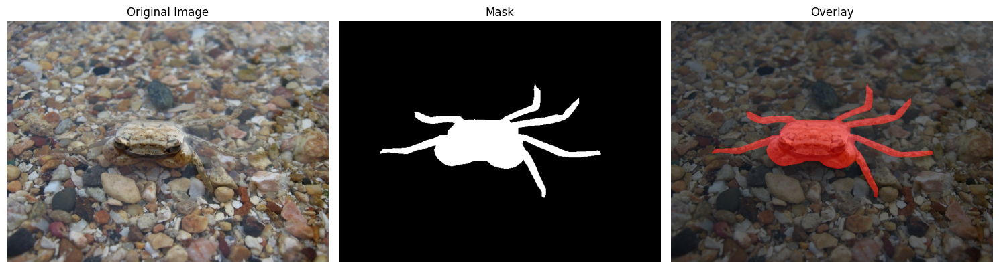

In [81]:
image_name = "COD10K-CAM-1-Aquatic-3-Crab-48"

img_path = f"data/cod/val/images/{image_name}.jpg"
mask_path = f"data/cod/val/masks/{image_name}.png"

visualize_example(img_path, mask_path)

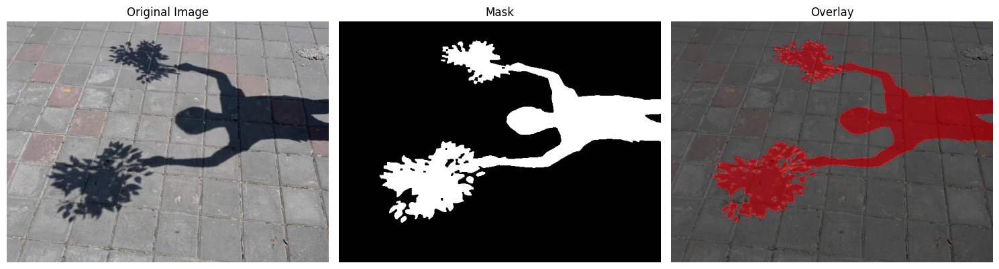

In [82]:
image_name = "134-13"

img_path = f"data/shadow/test/images/{image_name}.png"
mask_path = f"data/shadow/test/masks/{image_name}.png"

visualize_example(img_path, mask_path)

In [110]:
SHADOW_LORA_CHECKPOINT = "checkpoints/lora/shadow/lora_shadow/best_loss_model.pth"
SHADOW_ADAPTER_CHECKPOINT = "checkpoints/adapter/shadow/adapter_shadow/best_loss_model.pth"
SHADOW_ADAPTER_LORA_CHECKPOINT = "checkpoints/adapter_lora/shadow/adapter_lora_shadow/best_loss_model.pth"
SHADOW_LORA_CHECKPOINT_PROMPT = "checkpoints/lora/shadow/lora_shadow_prompt/best_loss_model.pth"
SHADOW_ADAPTER_CHECKPOINT_PROMPT = "checkpoints/adapter/shadow/adapter_shadow_prompt/best_loss_model.pth"
SHADOW_ADAPTER_LORA_CHECKPOINT_PROMPT = "checkpoints/adapter_lora/shadow/adapter_lora_shadow_prompt/best_loss_model.pth"
# SHADOW_LORA_CHECKPOINT = "checkpoints/lora/shadow/2025-10-21_16-02-43/best_model.pth"
# SHADOW_ADAPTER_CHECKPOINT = "checkpoints/adapter/shadow/2025-10-21_15-59-45/best_model.pth"
# SHADOW_ADAPTER_LORA_CHECKPOINT = "checkpoints/adapter_lora/shadow/2025-10-21_15-58-11/best_model.pth"

In [111]:
mobileSamAdapterShadow = MobileSAMBase()
mobileSamAdapterShadow.add_adapter()
load_checkpoint(mobileSamAdapterShadow, SHADOW_ADAPTER_CHECKPOINT)
mobileSamAdapterShadow.eval()

mobileSamLoraShadow = MobileSAMBase()
mobileSamLoraShadow.add_lora()
load_checkpoint(mobileSamLoraShadow, SHADOW_LORA_CHECKPOINT)
mobileSamLoraShadow.eval()


mobileSamBothShadow = MobileSAMBase()
mobileSamBothShadow.add_adapter()
mobileSamBothShadow.add_lora()
load_checkpoint(mobileSamBothShadow, SHADOW_ADAPTER_LORA_CHECKPOINT)
mobileSamBothShadow.eval()

mobileSamAdapterShadowPrompt = MobileSAMBase()
mobileSamAdapterShadowPrompt.add_adapter()
load_checkpoint(mobileSamAdapterShadowPrompt, SHADOW_ADAPTER_CHECKPOINT_PROMPT)
mobileSamAdapterShadowPrompt.eval()

mobileSamLoraShadowPrompt = MobileSAMBase()
mobileSamLoraShadowPrompt.add_lora()
load_checkpoint(mobileSamLoraShadowPrompt, SHADOW_LORA_CHECKPOINT_PROMPT)
mobileSamLoraShadowPrompt.eval()


mobileSamBothShadowPrompt = MobileSAMBase()
mobileSamBothShadowPrompt.add_adapter()
mobileSamBothShadowPrompt.add_lora()
load_checkpoint(mobileSamBothShadowPrompt, SHADOW_ADAPTER_LORA_CHECKPOINT_PROMPT)
mobileSamBothShadowPrompt.eval()


mobileSam = sam_model_registry["vit_t"](checkpoint=MOBILESAM_CHECPOINT)
mobileSam.eval()
print()

[INFO] Params before adding adapters:
[INFO] Trainable params: 0.000M
[INFO] Pretrained params: 0.000M
[INFO] Total params: 10.130M
[INFO] Adapter attached.
[INFO] Trainable params: 0.038M
[INFO] Pretrained params: 0.000M
[INFO] Total params: 10.168M
[INFO] Loading checkpoint from: checkpoints/adapter/shadow/adapter_shadow/best_loss_model.pth
[INFO] Checkpoint successfully loaded.
[INFO] Params before adding adapters:
[INFO] Trainable params: 0.000M
[INFO] Pretrained params: 0.000M
[INFO] Total params: 10.130M
[INFO] LoRA applied.
[INFO] Trainable params: 0.089M
[INFO] Pretrained params: 0.000M
[INFO] Total params: 10.219M
[INFO] Loading checkpoint from: checkpoints/lora/shadow/lora_shadow/best_loss_model.pth
[INFO] Checkpoint successfully loaded.
[INFO] Params before adding adapters:
[INFO] Trainable params: 0.000M
[INFO] Pretrained params: 0.000M
[INFO] Total params: 10.130M
[INFO] Adapter attached.
[INFO] Trainable params: 0.038M
[INFO] Pretrained params: 0.000M
[INFO] Total params:

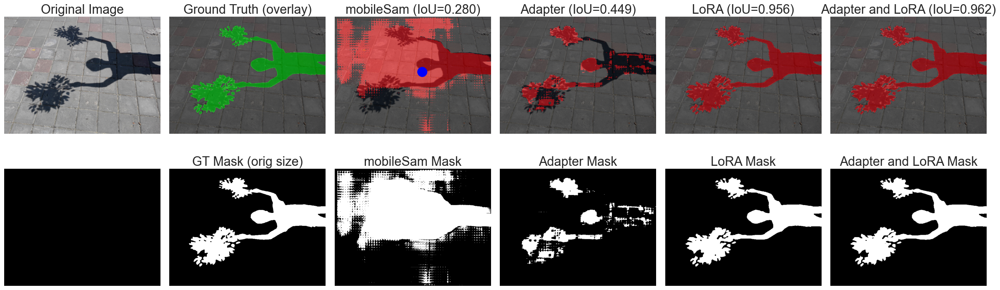

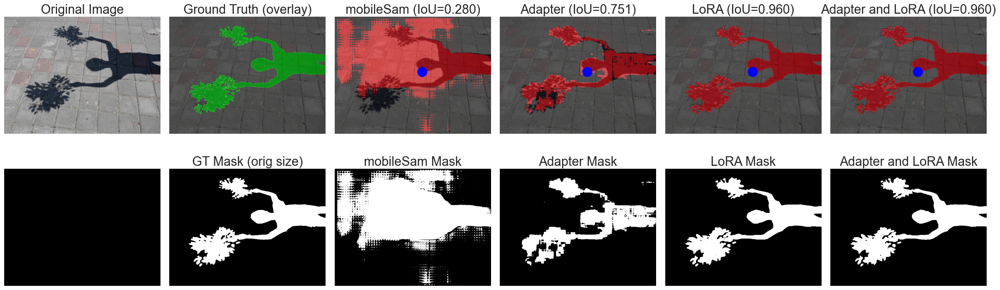

In [113]:


image_name = "134-13"

img_path = f"data/shadow/test/images/{image_name}.png"
mask_path = f"data/shadow/test/masks/{image_name}.png"


models = [("mobileSam", mobileSam), ("Adapter", mobileSamAdapterShadow), ("LoRA", mobileSamLoraShadow), ("Adapter and LoRA", mobileSamBothShadow)]

visualize_mobilesam_models(models, img_path, mask_path, legacy=False, help_sam=True, help_adapters=False)
print()

models = [("mobileSam", mobileSam), ("Adapter", mobileSamAdapterShadowPrompt), ("LoRA", mobileSamLoraShadowPrompt), ("Adapter and LoRA", mobileSamBothShadowPrompt)]

visualize_mobilesam_models(models, img_path, mask_path, legacy=False, help_sam=True, help_adapters=True)
print()

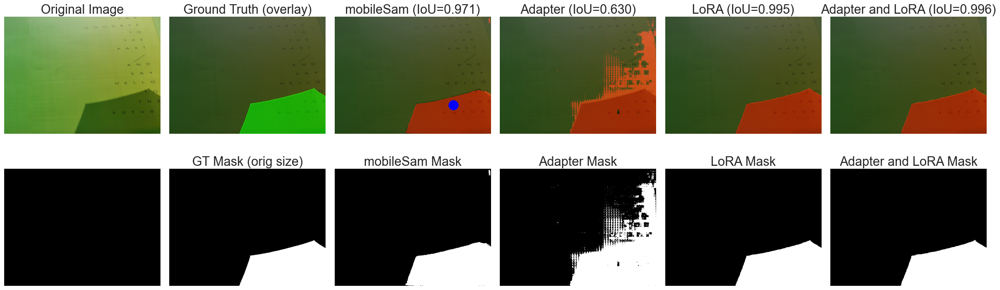

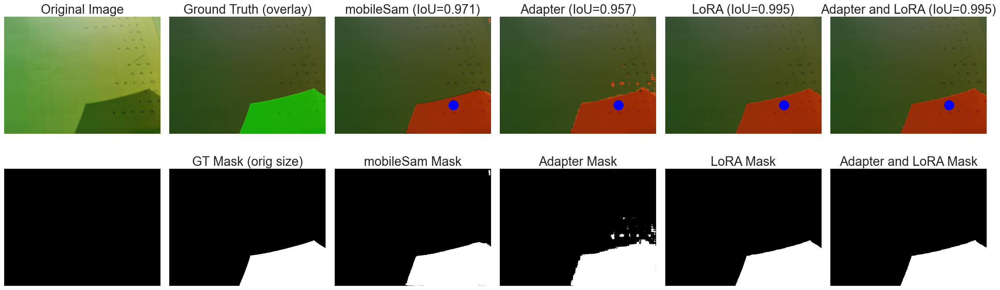

In [115]:
image_name = "96-2"

img_path = f"data/shadow/test/images/{image_name}.png"
mask_path = f"data/shadow/test/masks/{image_name}.png"


models = [("mobileSam", mobileSam), ("Adapter", mobileSamAdapterShadow), ("LoRA", mobileSamLoraShadow), ("Adapter and LoRA", mobileSamBothShadow)]

visualize_mobilesam_models(models, img_path, mask_path, legacy=False, help_sam=True, help_adapters=False)
print()

models = [("mobileSam", mobileSam), ("Adapter", mobileSamAdapterShadowPrompt), ("LoRA", mobileSamLoraShadowPrompt), ("Adapter and LoRA", mobileSamBothShadowPrompt)]

visualize_mobilesam_models(models, img_path, mask_path, legacy=False, help_sam=True, help_adapters=True)
print()

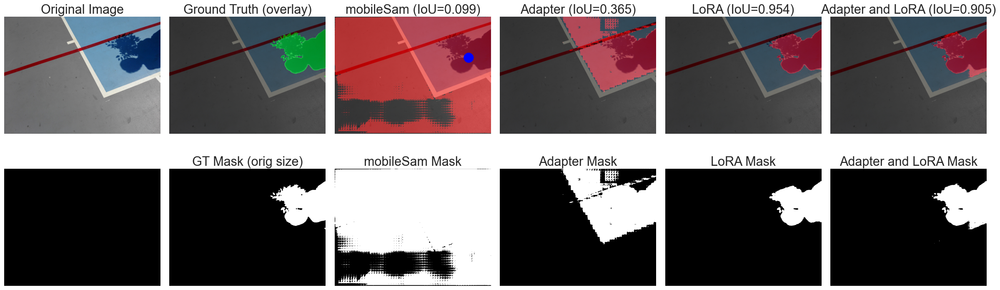

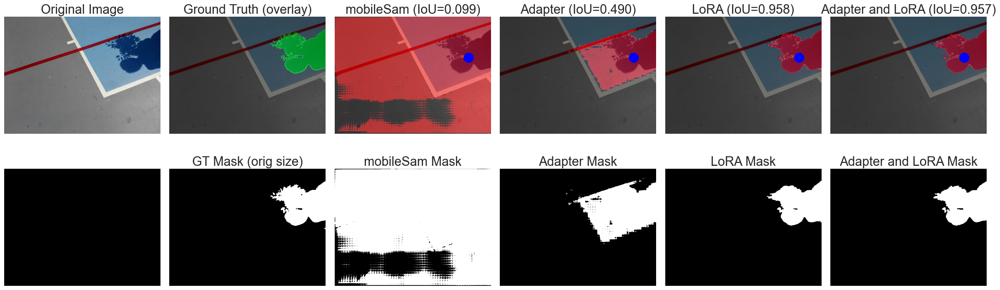

In [116]:
image_name = "133-24"

img_path = f"data/shadow/test/images/{image_name}.png"
mask_path = f"data/shadow/test/masks/{image_name}.png"


models = [("mobileSam", mobileSam), ("Adapter", mobileSamAdapterShadow), ("LoRA", mobileSamLoraShadow), ("Adapter and LoRA", mobileSamBothShadow)]

visualize_mobilesam_models(models, img_path, mask_path, legacy=False, help_sam=True, help_adapters=False)
print()

models = [("mobileSam", mobileSam), ("Adapter", mobileSamAdapterShadowPrompt), ("LoRA", mobileSamLoraShadowPrompt), ("Adapter and LoRA", mobileSamBothShadowPrompt)]

visualize_mobilesam_models(models, img_path, mask_path, legacy=False, help_sam=True, help_adapters=True)
print()


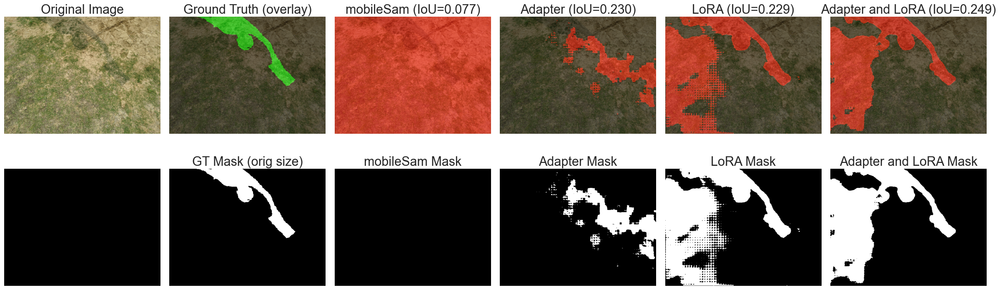

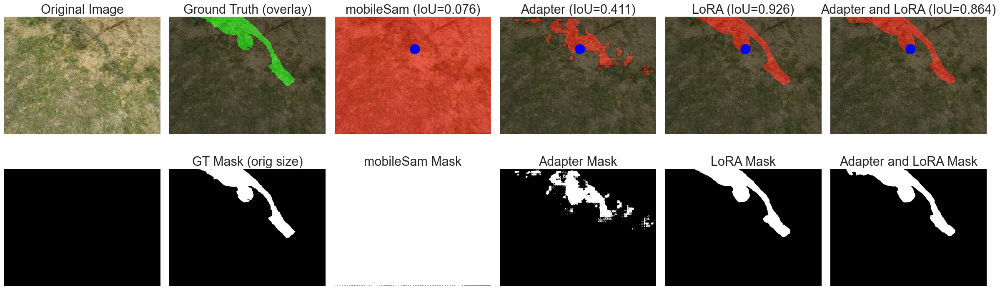

In [118]:
image_name = "94-3"

img_path = f"data/shadow/test/images/{image_name}.png"
mask_path = f"data/shadow/test/masks/{image_name}.png"


models = [("mobileSam", mobileSam), ("Adapter", mobileSamAdapterShadow), ("LoRA", mobileSamLoraShadow), ("Adapter and LoRA", mobileSamBothShadow)]

visualize_mobilesam_models(models, img_path, mask_path, legacy=False, help_sam=False, help_adapters=False)
print()

models = [("mobileSam", mobileSam), ("Adapter", mobileSamAdapterShadowPrompt), ("LoRA", mobileSamLoraShadowPrompt), ("Adapter and LoRA", mobileSamBothShadowPrompt)]

visualize_mobilesam_models(models, img_path, mask_path, legacy=False, help_sam=True, help_adapters=True)
print()


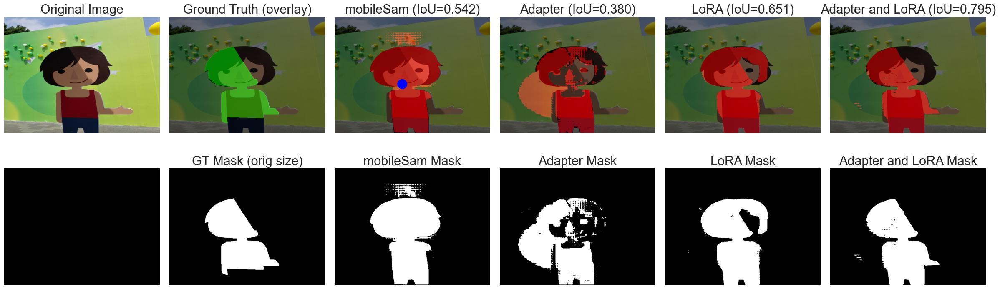

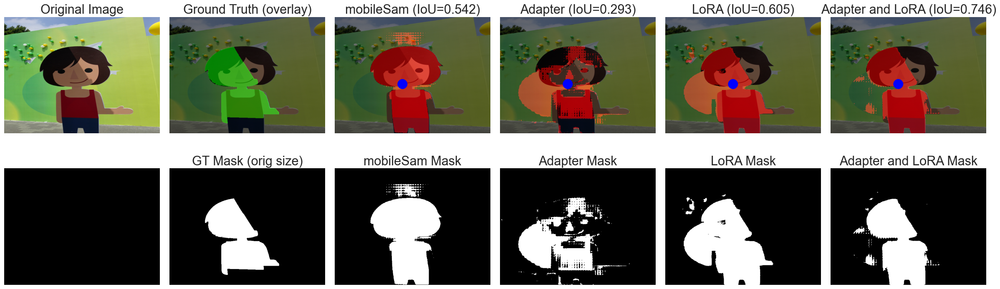

In [129]:
image_name = "129-6"

img_path = f"data/shadow/test/images/{image_name}.png"
mask_path = f"data/shadow/test/masks/{image_name}.png"


models = [("mobileSam", mobileSam), ("Adapter", mobileSamAdapterShadow), ("LoRA", mobileSamLoraShadow), ("Adapter and LoRA", mobileSamBothShadow)]

visualize_mobilesam_models(models, img_path, mask_path, legacy=False, help_sam=True, help_adapters=False)
print()

models = [("mobileSam", mobileSam), ("Adapter", mobileSamAdapterShadowPrompt), ("LoRA", mobileSamLoraShadowPrompt), ("Adapter and LoRA", mobileSamBothShadowPrompt)]

visualize_mobilesam_models(models, img_path, mask_path, legacy=False, help_sam=True, help_adapters=True)
print()

In [33]:
import pandas as pd

In [34]:
def load_cod_ious(csv_path):
    df = pd.read_csv(csv_path)
    df["category"] = df["image_name"].str.split("-").str[3]
    df["subcategory"] = df["image_name"].str.split("-").str[5].str.replace(".jpg", "")
    return df

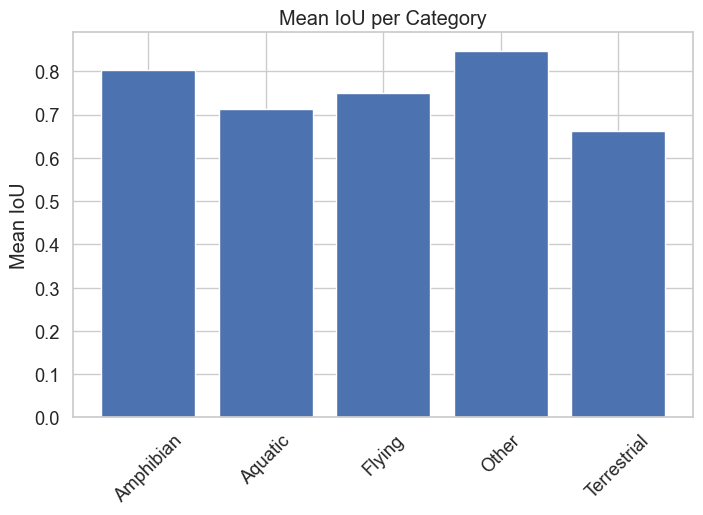

In [74]:
csv_path = "checkpoints/adapter_lora/cod/adapter_lora_cod_prompt/adapter_lora_best_loss_model_prompt_cod_test_ious.csv"
df = pd.read_csv(csv_path)
df["category"] = df["image_name"].str.split("-").str[3]
df["subcategory"] = df["image_name"].str.split("-").str[5].str.replace(".jpg", "")
df


mean_iou = df.groupby("category")["iou"].mean().reset_index()
mean_iou


plt.figure(figsize=(8,5))
plt.bar(mean_iou["category"], mean_iou["iou"])
plt.ylabel("Mean IoU")
plt.title("Mean IoU per Category")
plt.xticks(rotation=45)
plt.show()

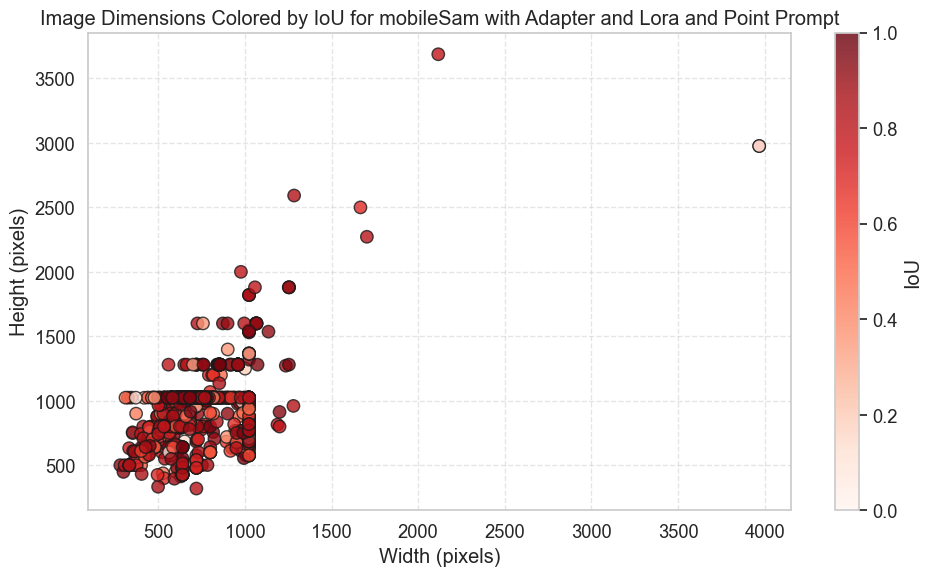

In [83]:
import matplotlib.pyplot as plt
import seaborn as sns

plt.figure(figsize=(10,6))
sns.set_theme(style="whitegrid", font_scale=1.2)

scatter = plt.scatter(
    x=df["width"],
    y=df["height"],
    c=df["iou"],
    cmap="Reds",
    s=80,       # marker size
    alpha=0.8,  # transparency
    edgecolor='k',  # optional: black border for markers
    vmin=0,
    vmax=1
)

plt.colorbar(scatter, label="IoU")  # add colorbar
plt.xlabel("Width (pixels)")
plt.ylabel("Height (pixels)")
plt.title("Image Dimensions Colored by IoU for mobileSam with Adapter and Lora and Point Prompt")
plt.grid(True, linestyle='--', alpha=0.5)
plt.tight_layout()
plt.show()

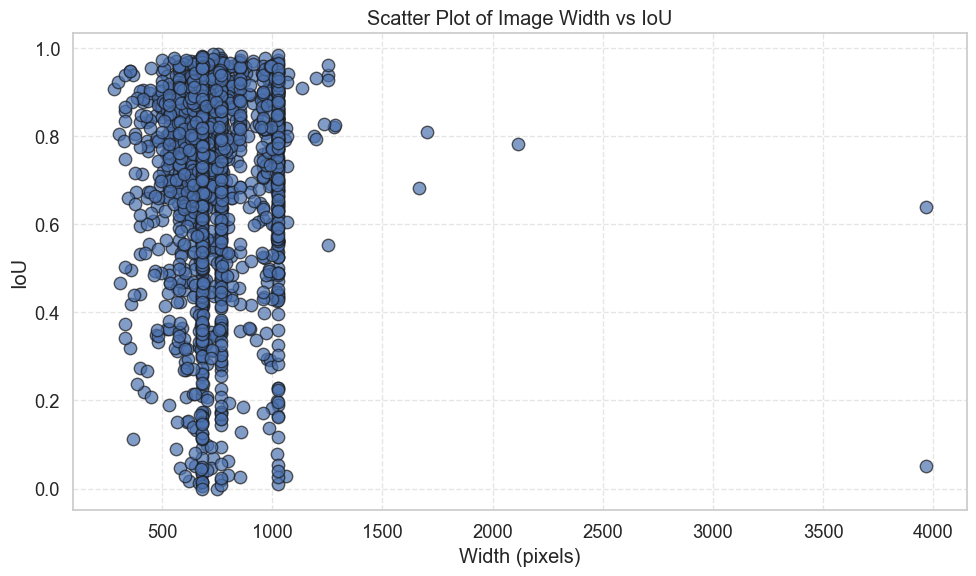

In [78]:
import matplotlib.pyplot as plt
import seaborn as sns

plt.figure(figsize=(10,6))
sns.set_theme(style="whitegrid", font_scale=1.2)

plt.scatter(
    x=df["width"],
    y=df["iou"],
    s=80,         # marker size
    alpha=0.7,    # transparency
    edgecolor='k'  # optional: black border
)

plt.xlabel("Width (pixels)")
plt.ylabel("IoU")
plt.title("Scatter Plot of Image Width vs IoU")
plt.grid(True, linestyle='--', alpha=0.5)
# plt.colorbar(label="IoU")  # optional if using c=df["iou"]
plt.tight_layout()
plt.show()

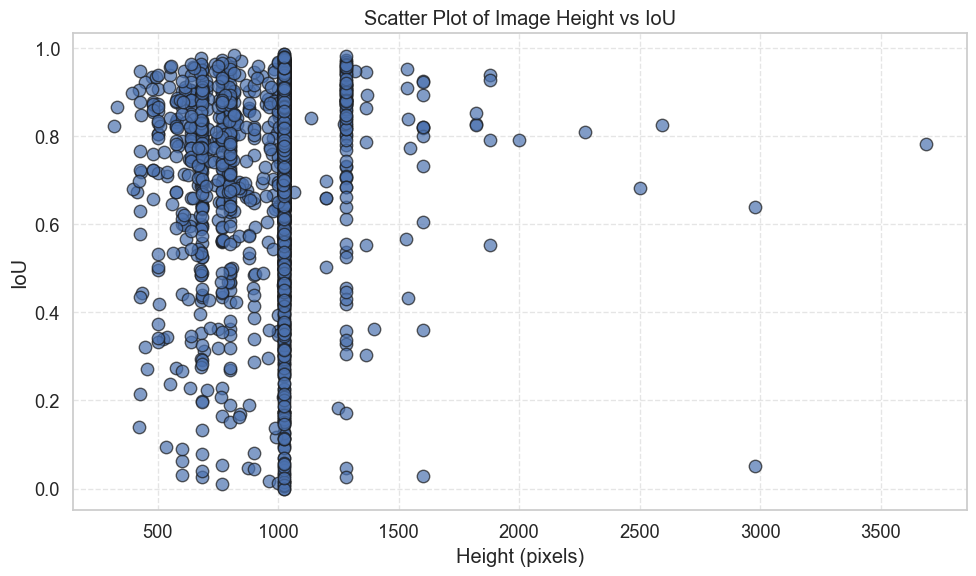

In [81]:
import matplotlib.pyplot as plt
import seaborn as sns

plt.figure(figsize=(10,6))
sns.set_theme(style="whitegrid", font_scale=1.2)

plt.scatter(
    x=df["height"],
    y=df["iou"],
    s=80,         # marker size
    alpha=0.7,    # transparency
    edgecolor='k'  # optional: black border
)

plt.xlabel("Height (pixels)")
plt.ylabel("IoU")
plt.title("Scatter Plot of Image Height vs IoU")
plt.grid(True, linestyle='--', alpha=0.5)
# plt.colorbar(label="IoU")  # optional if using c=df["iou"]
plt.tight_layout()
plt.show()

In [52]:
mean_iou = df.groupby("category")["iou"].mean().reset_index()
mean_iou

,category,iou
0,Amphibian,0.803085
1,Aquatic,0.711995
2,Flying,0.751104
3,Other,0.847550
4,Terrestrial,0.663236


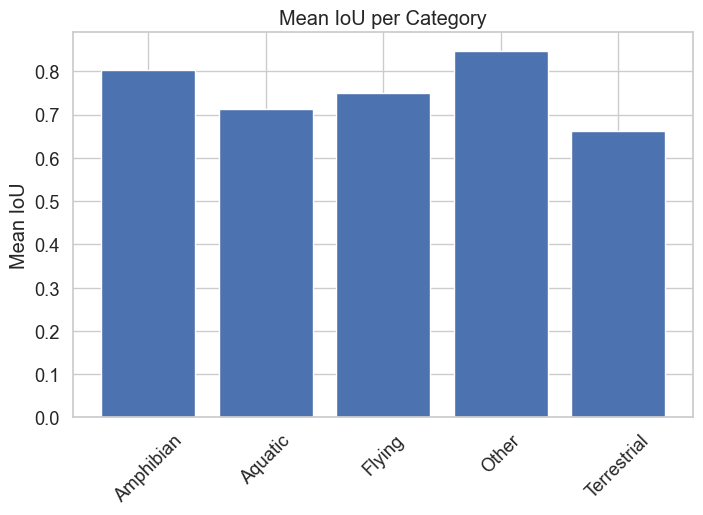

In [53]:

plt.figure(figsize=(8,5))
plt.bar(mean_iou["category"], mean_iou["iou"])
plt.ylabel("Mean IoU")
plt.title("Mean IoU per Category")
plt.xticks(rotation=45)
plt.show()

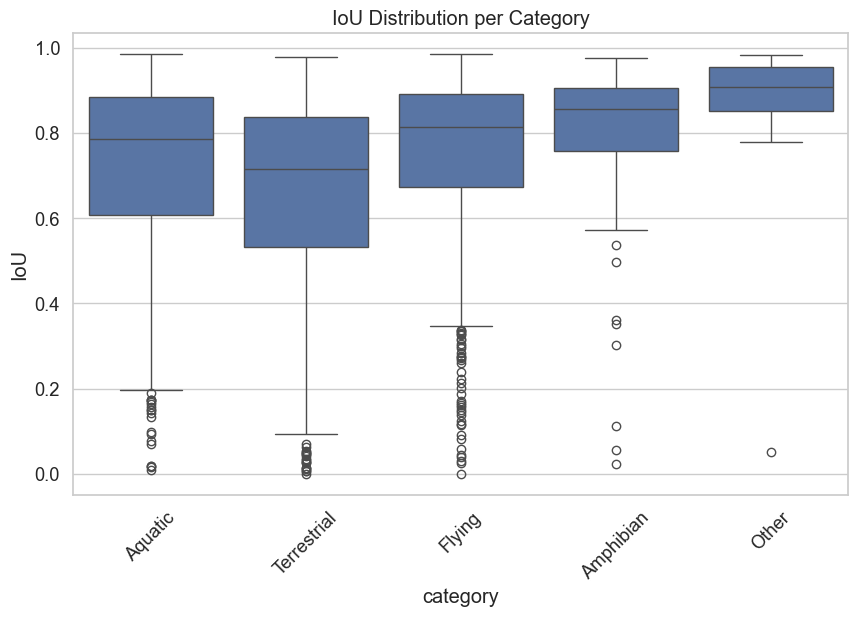

In [54]:

plt.figure(figsize=(10,6))
sns.boxplot(data=df, x="category", y="iou")
plt.ylabel("IoU")
plt.title("IoU Distribution per Category")
plt.xticks(rotation=45)
plt.show()

In [55]:
mean_iou_sub = df.groupby(["category", "subcategory"])["iou"].mean().reset_index()
mean_iou_sub

,category,subcategory,iou
0,Amphibian,Frog,0.786490
1,Amphibian,Toad,0.812212
2,Aquatic,BatFish,0.764591
3,Aquatic,ClownFish,0.681998
4,Aquatic,Crab,0.675373
...,...,...,...
64,Terrestrial,Spider,0.622978
65,Terrestrial,StickInsect,0.519092
66,Terrestrial,Tiger,0.418237
67,Terrestrial,Wolf,0.639451


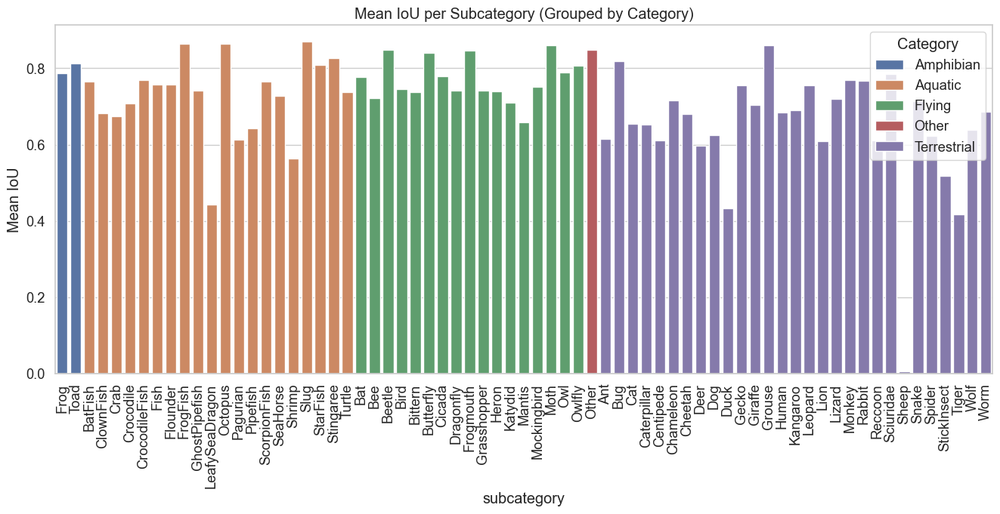

In [56]:

plt.figure(figsize=(16,6))
sns.barplot(data=mean_iou_sub, x="subcategory", y="iou", hue="category")
plt.xticks(rotation=90)
plt.ylabel("Mean IoU")
plt.title("Mean IoU per Subcategory (Grouped by Category)")
plt.legend(title="Category")
plt.show()

In [57]:
category_counts = df["category"].value_counts().reset_index()
category_counts.columns = ["category", "count"]

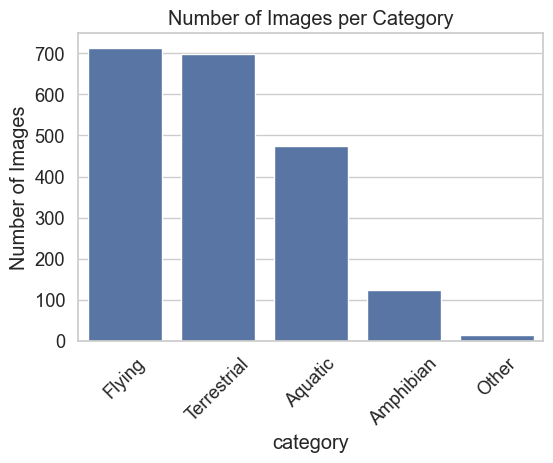

In [58]:

plt.figure(figsize=(6,4))
sns.barplot(data=category_counts, x="category", y="count")
plt.ylabel("Number of Images")
plt.title("Number of Images per Category")
plt.xticks(rotation=45)
plt.show()

In [59]:
subcategory_counts = df.groupby(["category", "subcategory"]).size().reset_index(name="count")

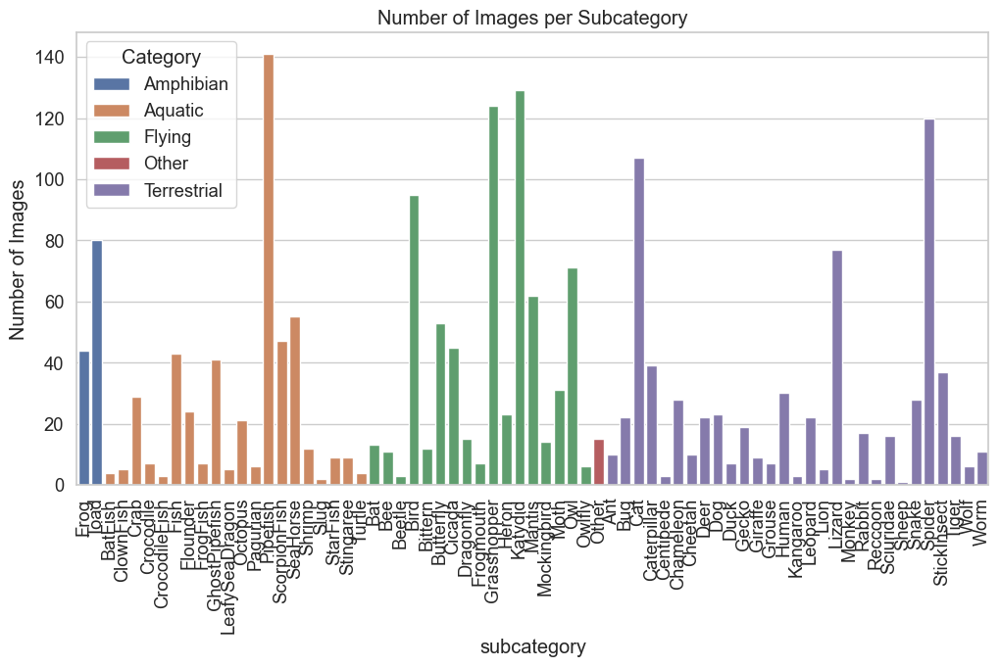

In [63]:
plt.figure(figsize=(12,6))
sns.barplot(data=subcategory_counts, x="subcategory", y="count", hue="category")
plt.xticks(rotation=90)
plt.ylabel("Number of Images")
plt.title("Number of Images per Subcategory")
plt.legend(title="Category")
plt.show()

In [61]:
mean_iou_sub = df.groupby(["category", "subcategory"])["iou"].mean().reset_index()

/var/folders/tq/q9s3yky11lz65mc1_ty64v540000gn/T/ipykernel_39961/3260964822.py:15: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=90)


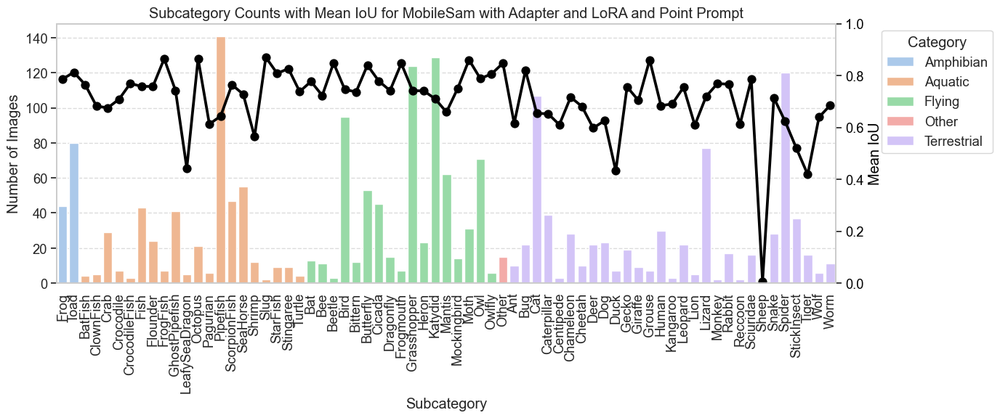

In [71]:
fig, ax1 = plt.subplots(figsize=(14,6))

# Barplot: subcategory counts
sns.barplot(
    data=subcategory_counts,
    x="subcategory",
    y="count",
    hue="category",
    dodge=False,
    palette="pastel",
    ax=ax1
)
ax1.set_ylabel("Number of Images")
ax1.set_xlabel("Subcategory")
ax1.set_xticklabels(ax1.get_xticklabels(), rotation=90)
ax1.set_title("Subcategory Counts with Mean IoU for MobileSam with Adapter and LoRA and Point Prompt")

# Move legend outside
ax1.legend(title="Category", bbox_to_anchor=(1.05, 1), loc="upper left")

# Secondary axis: mean IoU per subcategory
ax2 = ax1.twinx()
sns.pointplot(
    data=mean_iou_sub,
    x="subcategory",
    y="iou",
    color="black",
    markers="o",
    linestyles='-',
    ax=ax2
)
ax2.set_ylabel("Mean IoU", color="black")
ax2.tick_params(axis='y', labelcolor="black")
ax2.set_ylim(0,1)

# --- Clean up grids ---
ax1.grid(axis='y', linestyle='--', alpha=0.7)  # only horizontal grid for bar counts
ax2.grid(False)  # remove secondary axis grid
ax1.set_axisbelow(True)  # make sure bars are above grid

plt.tight_layout()
plt.show()

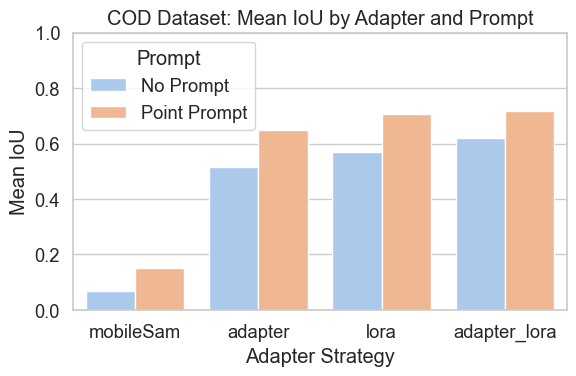

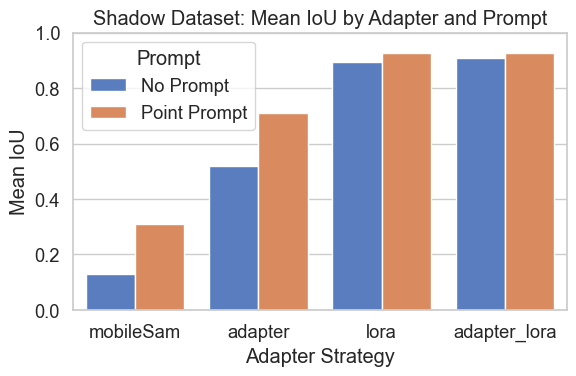

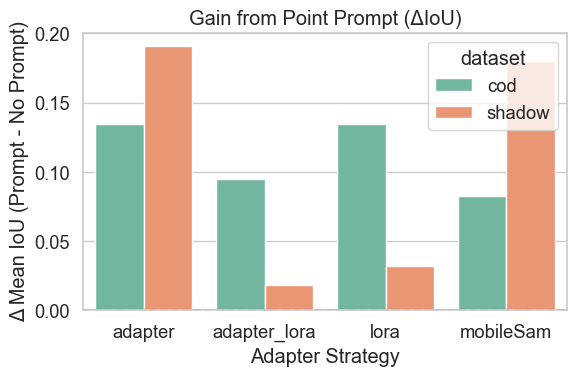

In [66]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from pathlib import Path

# --- Load all model results ---
records = []
for strategy in ["mobileSam", "adapter", "lora", "adapter_lora"]:
    for dataset in ["cod", "shadow"]:
        for prompt in ["", "_prompt"]:
            if strategy == "mobileSam":
                csv_path = Path(f"{strategy}_{dataset}{prompt}_test_ious.csv")
            else:
                csv_path = Path(f"checkpoints/{strategy}/{dataset}/{strategy}_{dataset}{prompt}/{strategy}_best_loss_model{prompt}_{dataset}_test_ious.csv")
            df = pd.read_csv(csv_path)
            mean_iou = df["iou"].mean()
            records.append({
                "strategy": strategy,
                "dataset": dataset,
                "prompt": "Point Prompt" if prompt == "_prompt" else "No Prompt",
                "mean_iou": mean_iou
            })

all_df = pd.DataFrame(records)

# --- 1. COD figure ---
cod_df = all_df[all_df["dataset"] == "cod"]
plt.figure(figsize=(6,4))
sns.barplot(data=cod_df, x="strategy", y="mean_iou", hue="prompt", palette="pastel")
plt.title("COD Dataset: Mean IoU by Adapter and Prompt")
plt.ylabel("Mean IoU")
plt.xlabel("Adapter Strategy")
plt.ylim(0, 1)
plt.legend(title="Prompt")
plt.tight_layout()
plt.show()

# --- 2. SHADOW figure ---
shadow_df = all_df[all_df["dataset"] == "shadow"]
plt.figure(figsize=(6,4))
sns.barplot(data=shadow_df, x="strategy", y="mean_iou", hue="prompt", palette="muted")
plt.title("Shadow Dataset: Mean IoU by Adapter and Prompt")
plt.ylabel("Mean IoU")
plt.xlabel("Adapter Strategy")
plt.ylim(0, 1)
plt.legend(title="Prompt")
plt.tight_layout()
plt.show()

# --- 3. Prompt effect figure ---
delta_df = (
    all_df.pivot_table(index=["dataset", "strategy"], columns="prompt", values="mean_iou")
    .assign(delta=lambda x: x["Point Prompt"] - x["No Prompt"])
    .reset_index()
)
plt.figure(figsize=(6,4))
sns.barplot(data=delta_df, x="strategy", y="delta", hue="dataset", palette="Set2")
plt.title("Gain from Point Prompt (ΔIoU)")
plt.ylabel("Δ Mean IoU (Prompt - No Prompt)")
plt.xlabel("Adapter Strategy")
plt.axhline(0, color="gray", linestyle="--")
plt.tight_layout()
plt.show()

/var/folders/tq/q9s3yky11lz65mc1_ty64v540000gn/T/ipykernel_39961/659049273.py:53: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(


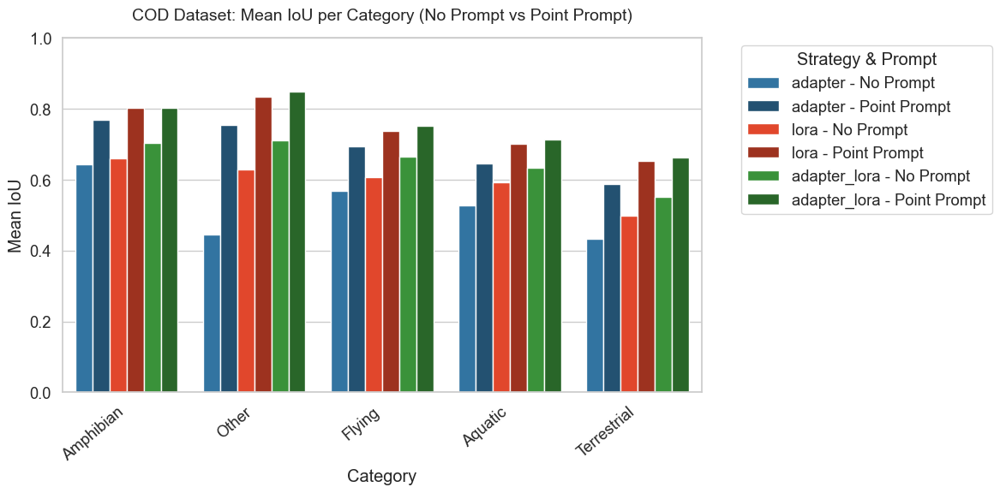

In [44]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.colors import to_rgb, to_hex
from pathlib import Path

# --- Load all COD model results ---
records = []
for strategy in ["adapter", "lora", "adapter_lora"]:
    for prompt in ["", "_prompt"]:
        csv_path = Path(
            f"checkpoints/{strategy}/cod/{strategy}_cod{prompt}/{strategy}_best_loss_model{prompt}_cod_test_ious.csv"
        )
        df = pd.read_csv(csv_path)
        df["category"] = df["image_name"].str.split("-").str[3]
        mean_iou = df.groupby("category")["iou"].mean().reset_index()
        mean_iou["strategy"] = strategy
        mean_iou["prompt"] = "Point Prompt" if prompt == "_prompt" else "No Prompt"
        records.append(mean_iou)

cod_df = pd.concat(records, ignore_index=True)

# --- Sort categories by average IoU ---
order = cod_df.groupby("category")["iou"].mean().sort_values(ascending=False).index
cod_df["category"] = pd.Categorical(cod_df["category"], categories=order, ordered=True)

# --- Combine strategy and prompt for plotting ---
cod_df["hue"] = cod_df["strategy"] + " - " + cod_df["prompt"]

# --- Define colors: base color per strategy, darker for Point Prompt ---
base_colors = {
    "adapter": "#1f77b4",       # blue
    "lora": "#ff320e",          # orange
    "adapter_lora": "#2ca02c"   # green
}

def make_shade(color_hex, prompt_type):
    rgb = to_rgb(color_hex)
    if prompt_type == "Point Prompt":
        # darken by 30%
        shaded = tuple(max(0, c*0.7) for c in rgb)
    else:
        # lighter: keep original
        shaded = rgb
    return to_hex(shaded)

cod_df["color"] = cod_df.apply(lambda r: make_shade(base_colors[r["strategy"]], r["prompt"]), axis=1)

# --- Plot ---
plt.figure(figsize=(12,6))
sns.set_theme(style="whitegrid", font_scale=1.2)

sns.barplot(
    data=cod_df,
    x="category",
    y="iou",
    hue="hue",
    palette=cod_df.set_index("hue")["color"].to_dict(),
    ci=None
)

plt.title("COD Dataset: Mean IoU per Category (No Prompt vs Point Prompt)", fontsize=14, pad=15)
plt.xlabel("Category")
plt.ylabel("Mean IoU")
plt.xticks(rotation=40, ha="right")
plt.ylim(0,1)

plt.legend(title="Strategy & Prompt", bbox_to_anchor=(1.05, 1), loc="upper left")
plt.tight_layout()
plt.show()

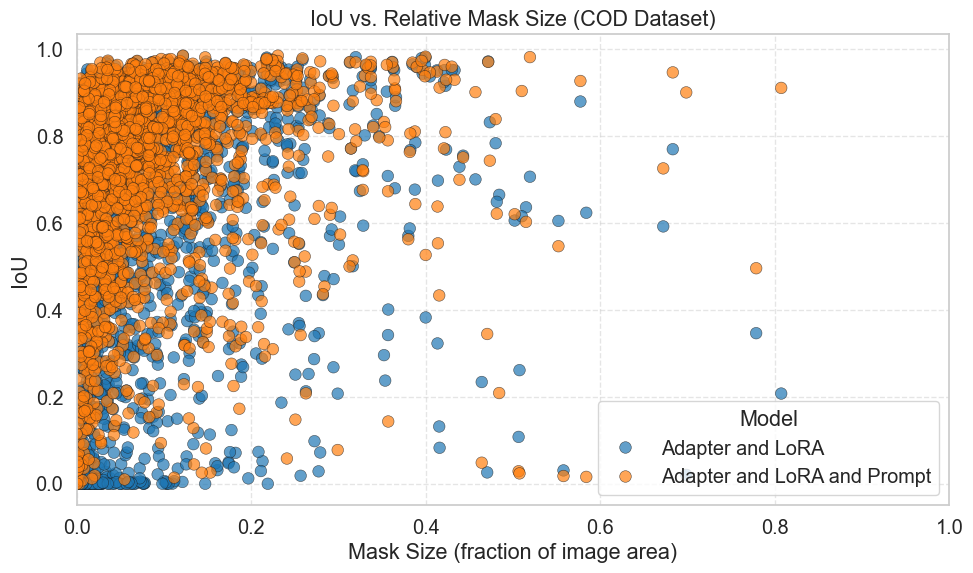

In [125]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from PIL import Image

# --- Configuration ---
mask_root = "./data/cod/test/masks"  # adjust to your actual GT mask folder

csv_paths = {
    "Adapter and LoRA": "checkpoints/adapter_lora/cod/adapter_lora_cod/adapter_lora_best_loss_model_cod_test_ious.csv",
    "Adapter and LoRA and Prompt": "checkpoints/adapter_lora/cod/adapter_lora_cod_prompt/adapter_lora_best_loss_model_prompt_cod_test_ious.csv",
}


# --- Load data and compute mask sizes ---

# --- LOAD DATA & COMPUTE MASK SIZES ---
records = []
for name, csv_path in csv_paths.items():
    df = pd.read_csv(csv_path)
    mask_areas, mask_fractions = [], []

    for i, img_name in enumerate(df["image_name"]):
        mask_path = os.path.join(mask_root, img_name.replace(".jpg", ".png"))
        if os.path.exists(mask_path):
            mask = np.array(Image.open(mask_path).convert("L")) > 0
            mask_area = mask.sum()
            total_area = df.loc[i, "width"] * df.loc[i, "height"]
            mask_areas.append(mask_area)
            mask_fractions.append(mask_area / total_area)
        else:
            mask_areas.append(np.nan)
            mask_fractions.append(np.nan)

    df["mask_area"] = mask_areas
    df["mask_fraction"] = mask_fractions
    df["model"] = name
    records.append(df)

df_all = pd.concat(records, ignore_index=True)
df_all = df_all.dropna(subset=["mask_fraction", "iou"])

# --- VISUALIZATION ---
sns.set_theme(style="whitegrid", font_scale=1.3)
plt.figure(figsize=(10,6))

palette = {
    "Adapter and LoRA": "#1f77b4",  # blue
    "Adapter and LoRA and Prompt": "#ff7f0e",     # orange
}

sns.scatterplot(
    data=df_all,
    x="mask_fraction",
    y="iou",
    hue="model",
    palette=palette,
    s=70,
    alpha=0.7,
    edgecolor="k",
    linewidth=0.4
)

plt.xlabel("Mask Size (fraction of image area)")
plt.ylabel("IoU")
plt.title("IoU vs. Relative Mask Size (COD Dataset)")
plt.xlim(0, 1)
plt.grid(True, linestyle="--", alpha=0.5)
plt.legend(title="Model", loc="lower right", frameon=True)
plt.tight_layout()
plt.show()

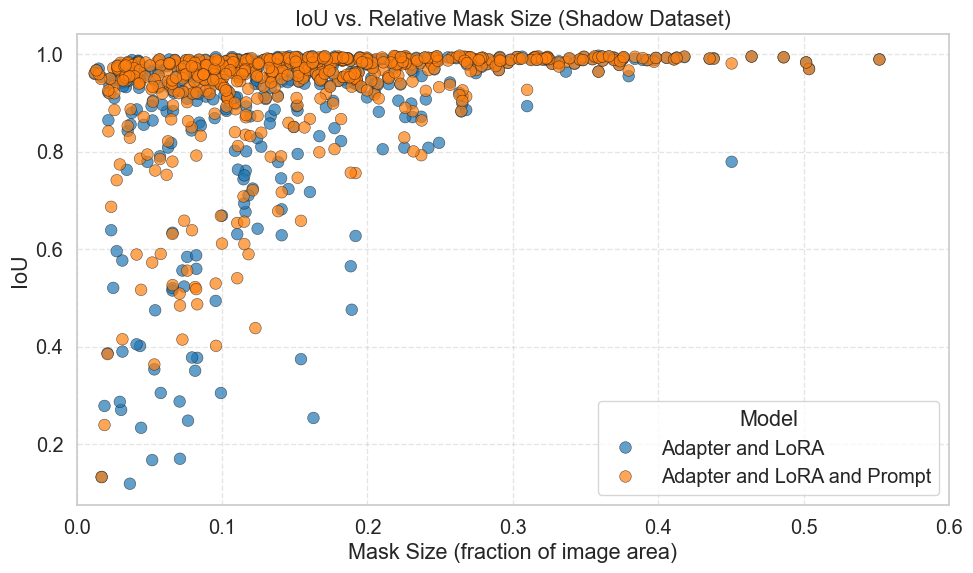

In [131]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from PIL import Image

# --- Configuration ---
mask_root = "./data/shadow/test/masks"  # adjust to your actual GT mask folder

csv_paths = {
    "Adapter and LoRA": "checkpoints/adapter_lora/shadow/adapter_lora_shadow/adapter_lora_best_loss_model_shadow_test_ious.csv",
    "Adapter and LoRA and Prompt": "checkpoints/adapter_lora/shadow/adapter_lora_shadow_prompt/adapter_lora_best_loss_model_prompt_shadow_test_ious.csv",
}


# --- Load data and compute mask sizes ---

# --- LOAD DATA & COMPUTE MASK SIZES ---
records = []
for name, csv_path in csv_paths.items():
    df = pd.read_csv(csv_path)
    mask_areas, mask_fractions = [], []

    for i, img_name in enumerate(df["image_name"]):
        mask_path = os.path.join(mask_root, img_name.replace(".jpg", ".png"))
        if os.path.exists(mask_path):
            mask = np.array(Image.open(mask_path).convert("L")) > 0
            mask_area = mask.sum()
            total_area = df.loc[i, "width"] * df.loc[i, "height"]
            mask_areas.append(mask_area)
            mask_fractions.append(mask_area / total_area)
        else:
            mask_areas.append(np.nan)
            mask_fractions.append(np.nan)

    df["mask_area"] = mask_areas
    df["mask_fraction"] = mask_fractions
    df["model"] = name
    records.append(df)

df_all = pd.concat(records, ignore_index=True)
df_all = df_all.dropna(subset=["mask_fraction", "iou"])

# --- VISUALIZATION ---
sns.set_theme(style="whitegrid", font_scale=1.3)
plt.figure(figsize=(10,6))

palette = {
    "Adapter and LoRA": "#1f77b4",  # blue
    "Adapter and LoRA and Prompt": "#ff7f0e",     # orange
}

sns.scatterplot(
    data=df_all,
    x="mask_fraction",
    y="iou",
    hue="model",
    palette=palette,
    s=70,
    alpha=0.7,
    edgecolor="k",
    linewidth=0.4
)

plt.xlabel("Mask Size (fraction of image area)")
plt.ylabel("IoU")
plt.title("IoU vs. Relative Mask Size (Shadow Dataset)")
plt.xlim(0, 0.6)
plt.grid(True, linestyle="--", alpha=0.5)
plt.legend(title="Model", loc="lower right", frameon=True)
plt.tight_layout()
plt.show()

/var/folders/tq/q9s3yky11lz65mc1_ty64v540000gn/T/ipykernel_39961/16136191.py:61: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(


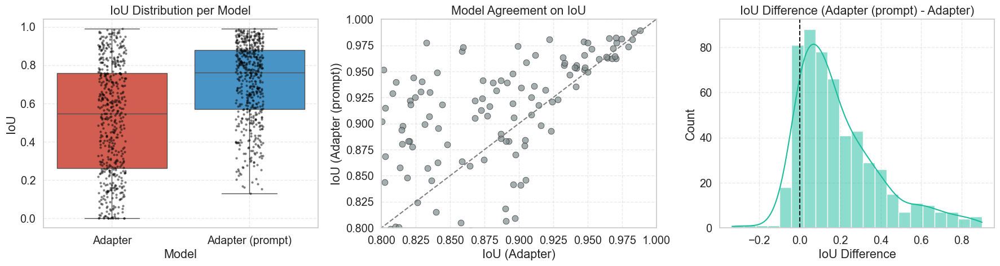

In [137]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# ----------------------------
# CONFIG
# ----------------------------
# csv_paths = {
#     "Adapter and LoRA": "checkpoints/adapter_lora/shadow/adapter_lora_shadow/adapter_lora_best_loss_model_shadow_test_ious.csv",
#     "Adapter and LoRA and Prompt": "checkpoints/adapter_lora/shadow/adapter_lora_shadow_prompt/adapter_lora_best_loss_model_prompt_shadow_test_ious.csv",
# }
# palette = {"Adapter and LoRA": "#E74C3C", "Adapter and LoRA and Prompt": "#3498DB"}  # red/blue pair


# csv_paths = {
#     "Adapter": "checkpoints/adapter/shadow/adapter_shadow/adapter_best_loss_model_shadow_test_ious.csv",
#     "LoRA": "checkpoints/lora/shadow/lora_shadow/lora_best_loss_model_shadow_test_ious.csv",
# }
# palette = {"Adapter": "#E74C3C", "LoRA": "#3498DB"}  # red/blue pair

csv_paths = {
    "Adapter": "checkpoints/adapter/shadow/adapter_shadow/adapter_best_loss_model_shadow_test_ious.csv",
    "Adapter (prompt)": "checkpoints/adapter/shadow/adapter_shadow_prompt/adapter_best_loss_model_prompt_shadow_test_ious.csv",
}
palette = {"Adapter": "#E74C3C", "Adapter (prompt)": "#3498DB"}  # red/blue pair

# csv_paths = {
#     "Adapter": "checkpoints/adapter/shadow/adapter_shadow/adapter_best_loss_model_shadow_test_ious.csv",
#     "Adapter and LoRA": "checkpoints/adapter_lora/shadow/adapter_lora_shadow/adapter_lora_best_loss_model_shadow_test_ious.csv",
# }
# palette = {"Adapter": "#E74C3C", "Adapter and LoRA": "#3498DB"}  # red/blue pair


sns.set_theme(style="whitegrid", font_scale=1.3)

# ----------------------------
# LOAD DATA
# ----------------------------
dfs = []
for name, path in csv_paths.items():
    df = pd.read_csv(path)
    df["model_name"] = name
    dfs.append(df)
df_all = pd.concat(dfs, ignore_index=True)

# Merge IoUs by image name for comparison
merged = None
for name, path in csv_paths.items():
    df = pd.read_csv(path)[["image_name", "iou"]].rename(columns={"iou": f"iou_{name}"})
    merged = df if merged is None else merged.merge(df, on="image_name")

merged["iou_diff"] = merged[f"iou_{list(csv_paths.keys())[1]}"] - merged[f"iou_{list(csv_paths.keys())[0]}"]

# ----------------------------
# CREATE FIGURE
# ----------------------------
fig, axes = plt.subplots(1, 3, figsize=(18, 5))
plt.subplots_adjust(wspace=0.3)

# --- (1) IoU DISTRIBUTION ---
sns.boxplot(
    data=df_all,
    x="model_name",
    y="iou",
    palette=palette,
    showfliers=False,
    ax=axes[0]
)
sns.stripplot(
    data=df_all,
    x="model_name",
    y="iou",
    color="black",
    size=3,
    alpha=0.5,
    ax=axes[0]
)
axes[0].set_title("IoU Distribution per Model")
axes[0].set_xlabel("Model")
axes[0].set_ylabel("IoU")

# --- (2) MODEL AGREEMENT ---
sns.scatterplot(
    data=merged,
    x=f"iou_{list(csv_paths.keys())[0]}",
    y=f"iou_{list(csv_paths.keys())[1]}",
    s=60,
    alpha=0.7,
    edgecolor="k",
    color="#7F8C8D",
    ax=axes[1]
)
axes[1].plot([0, 1], [0, 1], '--', color='gray')
axes[1].set_xlim(0.8, 1.0)
axes[1].set_ylim(0.8, 1.0)
axes[1].set_xlabel(f"IoU ({list(csv_paths.keys())[0]})")
axes[1].set_ylabel(f"IoU ({list(csv_paths.keys())[1]})")
axes[1].set_title("Model Agreement on IoU")

# --- (3) IOU DIFFERENCE HISTOGRAM ---
sns.histplot(merged["iou_diff"], kde=True, color="#1ABC9C", ax=axes[2])
axes[2].axvline(0, color="k", linestyle="--")
axes[2].set_title(f"IoU Difference ({list(csv_paths.keys())[1]} - {list(csv_paths.keys())[0]})")
axes[2].set_xlabel("IoU Difference")
axes[2].set_ylabel("Count")

# ----------------------------
# FINAL TOUCHES
# ----------------------------
for ax in axes:
    ax.grid(True, linestyle='--', alpha=0.4)

plt.tight_layout()
plt.show()

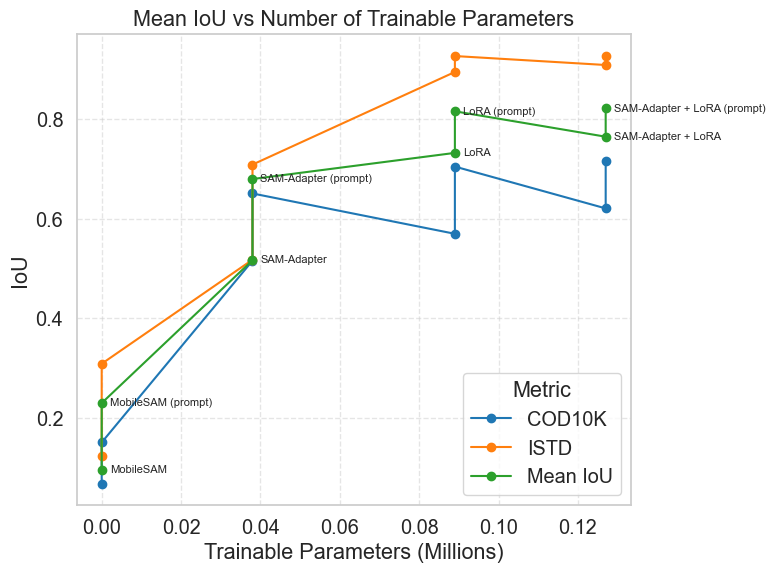

In [138]:
import matplotlib.pyplot as plt
import pandas as pd

# Data from tables
data = {
    "Model": [
        "MobileSAM", "MobileSAM (prompt)",
        "SAM-Adapter", "SAM-Adapter (prompt)",
        "LoRA", "LoRA (prompt)",
        "SAM-Adapter + LoRA", "SAM-Adapter + LoRA (prompt)"
    ],
    "COD10K": [0.068, 0.151, 0.516, 0.651, 0.570, 0.705, 0.621, 0.716],
    "ISTD": [0.123, 0.309, 0.518, 0.709, 0.895, 0.927, 0.909, 0.928],
    "Trainable (M)": [0.000, 0.000, 0.038, 0.038, 0.089, 0.089, 0.127, 0.127]
}

df = pd.DataFrame(data)

# Compute mean IoU
df["Mean IoU"] = df[["COD10K", "ISTD"]].mean(axis=1)

# Plot
plt.figure(figsize=(8,6))
for dataset, color in zip(["COD10K", "ISTD", "Mean IoU"], ["#1f77b4", "#ff7f0e", "#2ca02c"]):
    plt.plot(df["Trainable (M)"], df[dataset], 'o-', label=dataset, color=color)

# Annotate model names
for i, row in df.iterrows():
    plt.text(row["Trainable (M)"] + 0.002, row["Mean IoU"], row["Model"], fontsize=8, va='center')

plt.title("Mean IoU vs Number of Trainable Parameters")
plt.xlabel("Trainable Parameters (Millions)")
plt.ylabel("IoU")
plt.grid(True, linestyle="--", alpha=0.5)
plt.legend(title="Metric", loc="lower right")
plt.tight_layout()
plt.show()

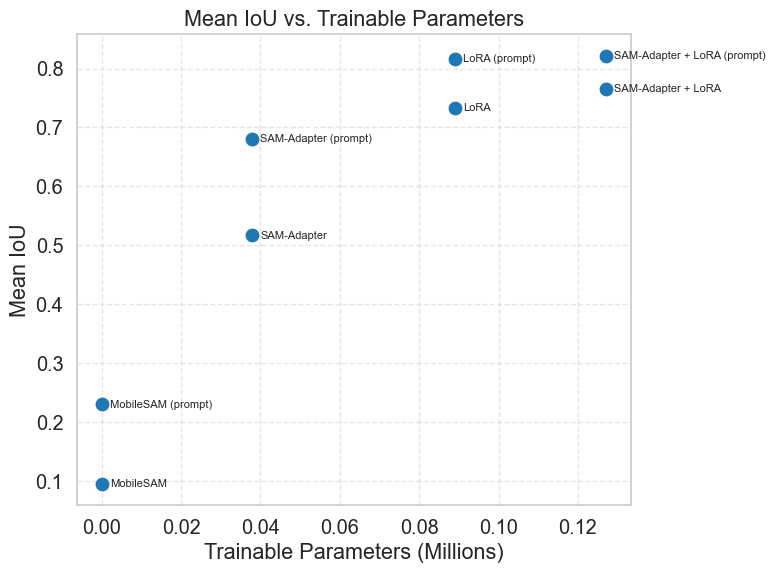

In [139]:
import matplotlib.pyplot as plt
import pandas as pd

# Data
data = {
    "Model": [
        "MobileSAM", "MobileSAM (prompt)",
        "SAM-Adapter", "SAM-Adapter (prompt)",
        "LoRA", "LoRA (prompt)",
        "SAM-Adapter + LoRA", "SAM-Adapter + LoRA (prompt)"
    ],
    "COD10K": [0.068, 0.151, 0.516, 0.651, 0.570, 0.705, 0.621, 0.716],
    "ISTD": [0.123, 0.309, 0.518, 0.709, 0.895, 0.927, 0.909, 0.928],
    "Trainable (M)": [0.000, 0.000, 0.038, 0.038, 0.089, 0.089, 0.127, 0.127]
}

df = pd.DataFrame(data)
df["Mean IoU"] = df[["COD10K", "ISTD"]].mean(axis=1)

# Scatter plot
plt.figure(figsize=(8,6))
plt.scatter(df["Trainable (M)"], df["Mean IoU"], s=80, color="#1f77b4")

# Annotate each point with model names
for i, row in df.iterrows():
    plt.text(row["Trainable (M)"] + 0.002, row["Mean IoU"], row["Model"], fontsize=8, va="center")

plt.title("Mean IoU vs. Trainable Parameters")
plt.xlabel("Trainable Parameters (Millions)")
plt.ylabel("Mean IoU")
plt.grid(True, linestyle="--", alpha=0.5)
plt.tight_layout()
plt.show()

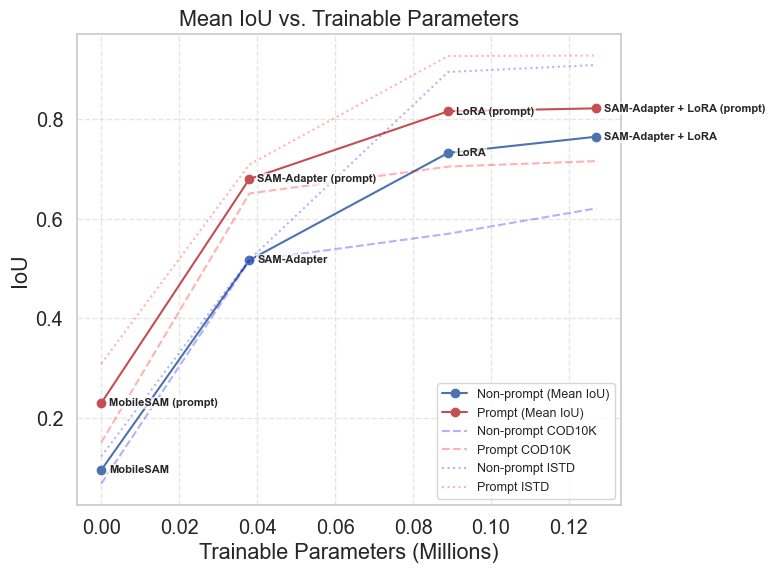

In [149]:
import matplotlib.pyplot as plt
import pandas as pd

# Data
data = {
    "Model": [
        "MobileSAM", "MobileSAM (prompt)",
        "SAM-Adapter", "SAM-Adapter (prompt)",
        "LoRA", "LoRA (prompt)",
        "SAM-Adapter + LoRA", "SAM-Adapter + LoRA (prompt)"
    ],
    "COD10K": [0.068, 0.151, 0.516, 0.651, 0.570, 0.705, 0.621, 0.716],
    "ISTD": [0.123, 0.309, 0.518, 0.709, 0.895, 0.927, 0.909, 0.928],
    "Trainable (M)": [0.000, 0.000, 0.038, 0.038, 0.089, 0.089, 0.127, 0.127]
}

df = pd.DataFrame(data)
df["Mean IoU"] = df[["COD10K", "ISTD"]].mean(axis=1)

plt.figure(figsize=(8,6))

# Indices for non-prompt and prompt models
non_prompt_idx = [0, 2, 4, 6]
prompt_idx = [1, 3, 5, 7]

# Plot mean IoU lines with markers (this also creates the scatter points)
plt.plot(df.loc[non_prompt_idx, "Trainable (M)"], df.loc[non_prompt_idx, "Mean IoU"], 
         'b-o', label="Non-prompt (Mean IoU)", linewidth=1.5)
plt.plot(df.loc[prompt_idx, "Trainable (M)"], df.loc[prompt_idx, "Mean IoU"], 
         'r-o', label="Prompt (Mean IoU)", linewidth=1.5)

# Annotate each point with model names using white background box
for i, row in df.iterrows():
    plt.text(
        row["Trainable (M)"] + 0.002, 
        row["Mean IoU"], 
        row["Model"], 
        fontsize=8, 
        va="center",
        ha="left",
        weight="bold",
        bbox=dict(facecolor='white', alpha=0.7, edgecolor='none', pad=1)
    )

# Task-specific lines (faded)
plt.plot(df.loc[non_prompt_idx, "Trainable (M)"], df.loc[non_prompt_idx, "COD10K"], 
         color='blue', alpha=0.3, linestyle='--', label="Non-prompt COD10K")
plt.plot(df.loc[prompt_idx, "Trainable (M)"], df.loc[prompt_idx, "COD10K"], 
         color='red', alpha=0.3, linestyle='--', label="Prompt COD10K")

plt.plot(df.loc[non_prompt_idx, "Trainable (M)"], df.loc[non_prompt_idx, "ISTD"], 
         color='blue', alpha=0.3, linestyle=':', label="Non-prompt ISTD")
plt.plot(df.loc[prompt_idx, "Trainable (M)"], df.loc[prompt_idx, "ISTD"], 
         color='red', alpha=0.3, linestyle=':', label="Prompt ISTD")

plt.title("Mean IoU vs. Trainable Parameters")
plt.xlabel("Trainable Parameters (Millions)")
plt.ylabel("IoU")
plt.grid(True, linestyle="--", alpha=0.5)

# Legend
plt.legend(loc="lower right", fontsize=9)
plt.tight_layout()
plt.show()